# PROJECT OVERVIEW

## File Saving Infrastructure

In [1]:
## Import Custom Functions and 
import functions_combined_BEST as ji
from functions_combined_BEST import ihelp, ihelp_menu,\
reload, inspect_variables

## IMPORT BS_DS PACKAGES
import bs_ds as bs
from bs_ds.imports import *
from pprint import pprint


# Import plotly and cufflinks for iplots
import plotly
import cufflinks as cf
cf.go_offline()

# Suppress warnings
import warnings
# warnings.filterwarnings('ignore')

# Set pd.set_options for tweet visibility
# pd.set_option('display.max_colwidth',100)

# Reload modules in case files have been updated
reload(ji)

bs_ds  v0.8.9 loaded.  Read the docs: https://bs-ds.readthedocs.io/en/latest/index.html
For convenient loading of standard modules use: from bs_ds.imports import *



Package,Handle,Description
bs_ds,bs,Custom data science bootcamp student package
matplotlib,mpl,Matplotlib's base OOP module with formatting artists
matplotlib.pyplot,plt,Matplotlib's matlab-like plotting module
numpy,np,scientific computing with Python
pandas,pd,High performance data structures and tools
seaborn,sns,High-level data visualization library based on matplotlib


In [ ]:
ihelp_menu([ji.load_processed_stock_data])

In [ ]:
## FUNCTIONS FOR SAVING MODEL
def df2png(df, filename_prefix = 'results/summary_table',sep='_',filename_suffix='',file_ext='.png',
           auto_filename_suffix=True, check_if_exists=True,save_excel=True,auto_increment_name=True, CSS=''):
    '''Accepts a dataframe and a filename (without extention). Saves an image of the stylized table.'''
    # Now save the css and html dataframe to the same text file before conversion
    import imgkit
    import os 
    import time
    import functions_combined_BEST as ji
    
    ## Specify file_format for imgkit
    if '.png' not in file_ext:
        file_format = file_ext.replace('.','')
        imgkitoptions = {'format':file_format}
    else:
        imgkitoptions = {'format':'png'}
     
    ## Provide path to required wkhtmltoimage.exe
    exe_path = "C:\\Program Files\\wkhtmltopdf\\bin\\wkhtmltoimage.exe"
    imgconfig = imgkit.config(wkhtmltoimage = exe_path) #'C:/Users/james/Anaconda3/envs/learn-env-ext/Lib/site-packages/wkhtmltopdf/bin/wkhtmltoimage.exe')

    ## CREATE ANY MISSING FOLDERS FOR DESIRED FOLDERPATH
    ji.create_required_folders(filename_prefix,verbose=0)
    
    ## CREATING FILENAMES
    # add auto suffix
    if auto_filename_suffix:
        suffix_time_format = '%m-%d-%Y_%I%M%p'
        filename = ji.auto_filename_time(prefix=filename_prefix, sep=sep, timeformat=suffix_time_format )
    else:
        filename = filename_prefix

    ## Add suffix to filename
    full_filename = filename + sep + filename_suffix + file_ext


    ## CHECK_IF_FILE_EXISTS
    if check_if_exists:
        import os
        import pandas as pd
        current_files = os.listdir()
        
        # check if file already exists and raise errror if no auto_increment_name
        if full_filename in current_files and auto_increment_name==False:
            raise Exception('Filename already exists')
        
        # if file already exists, find version number and increase by 1 
        elif full_filename in current_files and auto_increment_name==True:
        
            # check if filename ends in version #
            import re
            num_ending = re.compile(r'[vV].?(\d+)')#.json')
            
            curr_file_num = num_ending.findall(full_filename)
            if len(curr_file_num)==0:
                v_num = '_v01'
            else:
                v_num = f"_{int(curr_file_num)+1}"

            ## CHANGE FOR FILE EXTENTSION TYPE
            full_filename = filename +sep+ v_num +file_ext
            print(f'{filename} already exists... incrementing filename to {full_filename}.')

    
    
    ## Make temp filename for css/html text file export
    base_filename = full_filename.split('.')[0]
    text_file_name = base_filename +'_to_convert.html'
    
    ## Add text_file_name to Path [cant remmeber why?]
    from pathlib import Path
    config = Path(text_file_name)    
    if config.is_file():
        # Store configuration file values
        os.remove(text_file_name)

    
    ### GET HTML TABLE TO OUTPUT
    # Check df is styler or normal df
    if isinstance(df,pd.io.formats.style.Styler):
        html_df = df.render()
        
        if save_excel == True:
            df.to_excel(base_filename+'.xlsx')
            
    elif isinstance(df, pd.DataFrame):
        html_df = df.to_html()
        
        if save_excel == True:
            df.to_excel(base_filename+'.xlsx')
    elif isinstance(df,str):
        html_df=df

    
    ## Create text file with CSS and dataframe as cs
    with open(text_file_name,'a') as text_file:
        text_file.write(CSS)
        text_file.write(html_df)
#         text_file.close()

    ## Create image filename and produce figure from text file
    imagename = base_filename+file_ext
    imgkit.from_file(text_file_name, imagename, options = imgkitoptions, config=imgconfig)
    
    # report
#     print('')

    ## delete temporary text file
    os.remove(text_file_name)
    
    return 

#################################################################

def save_model_dfs(file_dict,model_key,df_model=None, df_results=None, df_shifted=None):
    import pandas as pd
    
    filenames = file_dict[model_key]
    
    list_to_save = ['df_model', 'df_results','df_shifted']
    dfs_to_save= [df_model, df_results,df_shifted]
    dict_to_save = dict(zip(list_to_save,dfs_to_save))#[eval(x) for x in list_to_save] ))

    for k,v in dict_to_save.items():
        fname = filenames[k]
        
        if isinstance(v,pd.DataFrame):
            v.to_csv(fname)
            print(f"[i] {k} saved as {fname}")
        
        elif isinstance(v,pd.io.formats.style.Styler):
            if '.' in fname:
                name_parts = fname.split('.')
                file_ext = name_parts[-1]
                filename_prefix = name_parts[0]
            else:
                filename_prefix=fname
            
                
            df2png(v, filename_prefix=fname,file_ext='.png',
                  auto_filename_suffix=False, auto_increment_name=False,
                  save_excel=True)
            show_name = filename_prefix+"."+file_ext
            print(f'[i] {k} saved as {show_name}')
        else:
            print(f'input df for {k} is neither a DataFrame or a Styler')
        

In [ ]:
ji.display_same_tweet_diff_cols()

In [2]:
## For each model need
#1) df_model for true_vs_preds_subplots
#2) df_results for tables (if cant use html export) (includes time_Shifted_metrics)
#3) df_shifted with traces for all shifts (maybe plot)
#4) save normal true_vs_pred_subplots 
reload(ji)
# def check_if_file_exists(filename,delim='/'):
#     import os
#     filename_parts = filename.split(delim)
# #     num_folders = len(filenameparts)-1
    
# #     check_path =filename_parts[0]
# #     for i in range(1,len(filename_parts)+1):
#     check_path = '/'.join(filename_parts[:-1])
#     current_files = os.listdir(check_path)
#     if filename_parts[-1] in current_files:
#         return True
#     else:
#         return False

def define_filename_dictionary(json_filename = 'data/test_filename_dictionary.json',show_dict=True,
                              create_folders=True,load_prior=True,save_directory=False):#,overwrite=False):
    """ Creates a file_dict with either the model_# or twitter_df/stock_df as kwds.
    Value is the filename (with extension) that should be used for saving/loading the file.
    filename_dictionary is reutrned and also saved to disk.
    
    Ex: For using with save_model_dfs():
        >>save_model_dfs(file_dict,'model1',
                       df_model=df_model1,
                      df_results=dfs_results1,
                      df_shifted=df_shifted1)
                      
    Ex: Using on its own:
        file_dict = define_filename_dictionary()
        >> twitter_df.read_csv(file_dict['twitter_df']['twitter_df_pre_stock_price'])
    """                  
    import os
    if load_prior ==True and os.path.isfile(json_filename):# and overwrite==False
        with open(json_filename,'r') as f:
            import json
            file_dict = json.loads(f.read())
            print(f"[i] filename_directory loaded from {json_filename}.")
    else:
        file_dict = {}
        
    if 'file_directory' not in file_dict.keys():
        file_dict['file_directory']={}
        file_dict['file_directory']['history'] = ''
        file_dict['file_directory']['filename'] = json_filename
                  
    ## Create entries for #'d models
    for i in ['0A','0B']:
        
        if f"model_{i}" not in file_dict.keys():
            file_dict[f"model_{i}"] ={}
                    
            file_dict[f'model_{i}'] = {'base_filename':f'models/NLP/nlp_model{i}',
                                   'output_filenames':{'model':'',
                                                       'weights':'',
                                                       'excel':'',
                                                       'params':''}}
        
            file_dict[f'model_{i}']['fig'] = f'results/model{i}/model{i}_conf_matrix'
            file_dict[f'model_{i}']['fig.ext'] = f'results/model{i}/model{i}_conf_matrix.png'
        
        
    for i in ['sarima','1','2','3']:
        
        if f"model_{i}" not in file_dict.keys():

            file_dict[f"model_{i}"] ={}
            file_dict[f'model_{i}'] = {'base_filename':f'models/stocks/model{i}_',
                               'output_filenames':{'model':'',
                                                   'weights':'',
                                                   'excel':'',
                                                   'params':''}}

            file_dict[f'model_{i}']['df_model'] = f'results/model{i}/model{i}_df_model_true_vs_preds.csv'
            file_dict[f'model_{i}']['df_results'] = f'results/model{i}/model{i}_df_results.xlsx' 
            file_dict[f'model_{i}']['df_shifted'] = f'results/model{i}/model{i}_df_shifted.csv'

            file_dict[f'model_{i}']['fig'] = f'results/model{i}/model{i}_true_vs_preds'
            file_dict[f'model_{i}']['fig.ext'] = f'results/model{i}/model{i}_true_vs_preds.png'
            file_dict[f'model_{i}']['fig_shifted'] = f'results/model{i}/model{i}_true_vs_preds_shifted'
            file_dict[f'model_{i}']['fig_shifted.ext'] = f'results/model{i}/model{i}_true_vs_preds_shifted.png'


    ## ADD NAMES OF OTHER FILES
    if 'twitter_df' not in file_dict.keys():
        file_dict['twitter_df']={
            'raw_tweet_file':'data/trumptwitterarchive_export_iphone_only__08_23_2019.csv',
            'twitter_df_pre_stock_price':'data/_twitter_df_before_stock_price.csv',
            'twitter_df_post_stock_price':'data/_twitter_df_with_stock_price.csv'}
        
    if 'stock_df' not in file_dict.keys():

        file_dict['stock_df'] ={'raw_text_file':'data/IVE_bidask1min_08_23_2019.txt',
                                'raw_csv_file':'data/IVE_bidask1min_08_23_2019.csv',
                                'stock_df_with_indicators':'data/_stock_df_with_technical_indicators.csv',
                               'stock_df_input_model1':'data/stock_df_for_model1.csv',
                               'stock_price_for_twitter_df':"data/IVE_bidask1min_08_23_2019.csv"}

    if 'nlp_figures' not in file_dict.keys():
        file_dict['nlp_figures']={'word_clouds_compare':'figures/wordcloud_top_words_by_delta_price.png',
                                 'word_clouds_compare_unique':'figures/wordcloud_unique_words_by_delta_price.png',
                                  'freq_dist_plots':'figures/freq_dist_plots_by_delta_price.png'
                                 }
        
    if 'nlp_model_for_predictions' not in file_dict.keys():

        file_dict['nlp_model_for_predictions'] = {'base_filename':'models/best_final/nlp_classifier_model',
                                                 'output_filenames':{'model':'','weights':'',
                                                                     'excel':'','params':''}}
        
    if 'word2vec' not in file_dict.keys():
        file_dict['word2vec'] = {'base_filename':'models/word2vec/word2vec_model.pkl'}
    
    if 'df_combined' not in file_dict.keys():
        file_dict['df_combined'] = {}
        file_dict['df_combined']['pre_nlp'] = 'data/_combined_stock_data_raw_tweets.csv'
        file_dict['df_combined']['post_nlp'] = 'data/_combined_stock_data_plus_nlp.csv'
        file_dict['df_combined']['with_preds'] = 'data/_combined_stock_data_with_tweet_preds.csv'
    
    if show_dict:
        ji.display_dict_dropdown(file_dict)
        
    if save_directory:
        # check if file already exists and raise errror if no auto_increment_name
#         if full_filename in current_files and auto_increment_name==False:
        ## save the directory json file
        with open(json_filename,'w') as f:
            import json
            json_file_dict = json.dumps(file_dict)
            f.write(json_file_dict)
            print(f"[i] filename_directory saved to {json_filename}.")
            print('\t - use `update_file_directory(file_dict)` to update file.')

    if create_folders:
        print(f"[i] creating all required folders...")
        for k,v in file_dict.items():
            if isinstance(v,dict):
                 for k2,v2 in file_dict[k].items():
                    if '/' in v2:
                        ji.create_required_folders(v2,verbose=1)

            elif '/' in v:
                ji.create_required_folders(v,verbose=1)



    return file_dict

# def load_file_directory(file_dict_filename='')

def update_file_directory(file_dict):
    file_dir = file_dict['file_directory']
    
    with open(file_dir,'w+') as f:
        import json
        json_file_dict = json.dumps(file_dict)
        f.write(json_file_dict)
        f.seek(0)
    print(f"[i]filename_directory updated, filename='{file_dir}'")
    

    # export = [df_model1,dfs_results,df_shifted]
file_dict = define_filename_dictionary(show_dict=True,create_folders=True)

[i] filename_directory loaded from data/test_filename_dictionary.json.
------------ Dictionary Contents ------------


interactive(children=(Dropdown(description='dict_to_display', options={'file_directory': {'history': '', 'file…

[i] creating all required folders...


In [ ]:
## DEFINING ASSET LIST
df_list = [['model','df_type','filename']]
for i in [1,2,3]:
    df_type = "df_model"
    filename = f'assets/model_{i}/df_model.csv'
    df_list.append([i,df_type,filename])
    
df_dir = bs.list2df(df_list)

# LOAD & PROCESS RAW STOCK DATA

In [3]:
# DISPLAY CODE TO BE USED BELOW TO LOAD AND PROCESS STOCK DATA
functions_used=['ji.load_processed_stock_data', # This script combines the oriignal 4 used:
                'ji.load_raw_stock_data_from_txt',
                'ji.set_timeindex_freq','ji.custom_BH_freq',
               'ji.get_technical_indicators']

ji.ihelp_menu(functions_used)

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('ji.load…

Output()

In [4]:
ji.display_dict_dropdown(file_dict['stock_df'])

------------ Dictionary Contents ------------


interactive(children=(Dropdown(description='dict_to_display', options={'raw_text_file': 'data/IVE_bidask1min_0…

In [5]:
## Load in raw text file with minute-resolutin S&P 500 prices
reload(ji)
fname = file_dict['stock_df']['raw_csv_file']
raw_stock_df = ji.load_raw_stock_data_from_txt(filename = fname,
                                               verbose=2)

[i] Loading data/IVE_bidask1min_08_23_2019.csv...

[i] Exlcuding data earlier than 2016-12-01.
[i] Cleaning 0 values:
	 -replaced 12 zeroes in "BidClose" with np.nan ...".
	- dropping null values (`fill_or_drop_null`).
[i] Converting the datetimeindex to `freq` "CBH"
	- addressing resulting null values using fill_method ffill...
------------------------------------------------------------
INDEX REPORT:
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 09:30:00 -- to -- 2019-08-23 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,date_time_index,Date,Time,BidOpen,BidHigh,BidLow,BidClose,AskOpen,AskHigh,AskLow,AskClose,filled_timebin
date_time_index,,,,,,,,,,,,
2016-12-01 09:30:00,2016-12-01 09:30:00,12/01/2016,09:30,93.78,93.99,93.78,93.95,94.05,94.05,93.97,94.04,False
2016-12-01 10:30:00,2016-12-01 10:30:00,12/01/2016,10:30,94.16,94.16,94.09,94.1,94.17,94.17,94.1,94.11,False
2016-12-01 11:30:00,2016-12-01 11:30:00,12/01/2016,11:30,94.16,94.17,94.15,94.17,94.17,94.18,94.16,94.18,False
2016-12-01 12:30:00,2016-12-01 12:30:00,12/01/2016,12:30,94.21,94.21,94.21,94.21,94.22,94.22,94.22,94.22,False
2016-12-01 13:30:00,2016-12-01 13:30:00,12/01/2016,13:30,93.96,93.96,93.96,93.96,93.97,93.97,93.97,93.97,False


In [6]:
fig = ji.plotly_time_series(raw_stock_df, y_col='BidClose',as_figure=True)
stock_df = ji.get_technical_indicators(raw_stock_df,make_price_from='BidClose')
del raw_stock_df

In [7]:
# SELECT DESIRED COLUMNS
stock_df = stock_df[[
    'price','ma7','ma21','26ema','12ema','MACD','20sd',
    'upper_band','lower_band','ema','momentum','filled_timebin']]#,'filled_timebin'

# Make stock_price for twitter functions
stock_df.dropna(inplace=True)
ji.index_report(stock_df)
display(stock_df.head(3))

------------------------------------------------------------
INDEX REPORT:
------------------------------------------------------------
* Index Endpoints:
	2016-12-29 15:30:00 -- to -- 2019-08-23 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,filled_timebin
date_time_index,,,,,,,,,,,,
2016-12-29 15:30:00,96.27,96.864898,96.277007,96.573856,96.730494,0.156639,1.002051,98.281110,94.272904,96.263988,89.27,False
2016-12-30 09:30:00,96.38,96.850204,96.293537,96.571218,96.721997,0.150779,0.980655,98.254848,94.332227,96.341329,89.38,False
2016-12-30 10:30:00,96.21,96.831633,96.307891,96.566317,96.709593,0.143275,0.959724,98.227340,94.388442,96.253776,89.21,False


In [8]:
reload(ji)
fig = ji.plotly_technical_indicators(stock_df)
# del raw_stock_df

In [9]:
# save cleaned with tech indicators 
fname = file_dict['stock_df']['stock_df_with_indicators']
stock_df.to_csv(fname)

In [10]:
ji.disp_df_head_tail(stock_df)

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,filled_timebin
date_time_index,,,,,,,,,,,,
2016-12-29 15:30:00,96.27,96.8649,96.277,96.5739,96.7305,0.156639,1.00205,98.2811,94.2729,96.264,89.27,False
2016-12-30 09:30:00,96.38,96.8502,96.2935,96.5712,96.722,0.150779,0.980655,98.2548,94.3322,96.3413,89.38,False
2016-12-30 10:30:00,96.21,96.8316,96.3079,96.5663,96.7096,0.143275,0.959724,98.2273,94.3884,96.2538,89.21,False


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,filled_timebin
date_time_index,,,,,,,,,,,,
2019-08-23 13:30:00,112.72,114.303,115.583,115.479,114.785,-0.694321,2.36254,120.308,110.858,112.944,105.72,False
2019-08-23 14:30:00,112.91,114.315,115.54,115.451,114.74,-0.710353,2.3435,120.227,110.853,112.921,105.91,False
2019-08-23 15:30:00,112.45,114.323,115.495,115.418,114.687,-0.73145,2.32481,120.144,110.845,112.607,105.45,False


## Checking for Stationarity and Trends

In [11]:
fun_used=['stationarity_check', 'adf_test']
ihelp_menu(fun_used)

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('station…

Output()

C:\Users\james\Anaconda3\envs\learn-env-ext\lib\site-packages\pandas\plotting\_converter.py:129: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



Results of Dickey-Fuller Test:
	If p<.05 then timeseries IS stationary.
Test Statistic                   -2.070187
p-value                           0.256670
#Lags Used                       32.000000
Number of Observations Used    4805.000000
Critical Value (1%)              -3.431712
Critical Value (5%)              -2.862142
Critical Value (10%)             -2.567090
dtype: float64


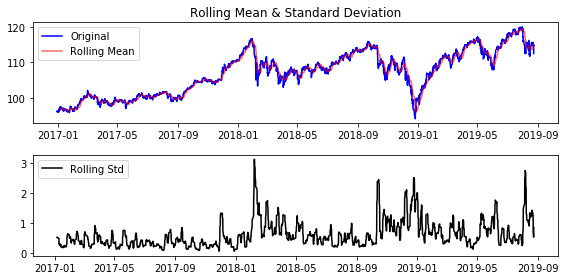

In [12]:
## STATIONARITY CHECK
# Check if stationary 
ji.stationarity_check(stock_df,  window=35, col='price',freq=ji.custom_BH_freq())

In [13]:
## SEASONAL DECOMPOSITION
from statsmodels.tsa.seasonal import seasonal_decompose
result = seasonal_decompose(stock_df['price'], freq=35)#35=1 business week

# with plt.rc_context({'figure.figsize': (8,5)}):
#     result.plot();

## Interactive plot of seasonal decomposition
stock_observed = result.observed.rename('true price')
stock_trend = result.trend.rename('trend')
stock_seasonal = result.seasonal.rename('seasonal')
stock_residual = result.resid.rename('residual')

## Concatenate decomposition components
df_decomp = pd.concat([stock_observed,stock_trend, stock_seasonal, stock_residual],axis=1)

# Plotly Plot of Result
my_layout = ji.def_my_layout_solar_theme()
df_decomp.iplot(asDates=True,subplots=True,shape=(4,1), layout=my_layout,shared_xaxes=True)

# Get ADF Stationarity Check for all components
for col in df_decomp.columns:
    print('---'*20)
    print(f"Column: {col}")
    print('---'*10)
    ji.adf_test(df_decomp[col])
    print('---'*20,'\n')

------------------------------------------------------------
Column: true price
------------------------------
Augmented Dickey-Fuller Test: 
ADF test statistic        -2.070187
p-value                    0.256670
# lags used               32.000000
# observations          4805.000000
critical value (1%)       -3.431712
critical value (5%)       -2.862142
critical value (10%)      -2.567090
Weak evidence against the null hypothesis
Fail to reject the null hypothesis
Data has a unit root and is non-stationary
------------------------------------------------------------ 

------------------------------------------------------------
Column: trend
------------------------------
Augmented Dickey-Fuller Test: 
ADF test statistic        -1.754465
p-value                    0.403291
# lags used               32.000000
# observations          4771.000000
critical value (1%)       -3.431721
critical value (5%)       -2.862146
critical value (10%)      -2.567093
Weak evidence against the null hyp

# INITIAL MODEL 

In [14]:
skip=True
## VISUALIZE PACF AND ACF FUNCTIONS
if skip==False:
    ## VISUALIZE PACF AND ACF FUNCTIONS
    from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
    plot_df = stock_df['price']

    # Create subplots 
    fig,ax = plt.subplots(nrows=3,ncols=1, figsize=(12,6),sharex=False)
    plot_df.plot(ax=ax[0])
    
    ## Set labels for subplot axes
    ax[-1].set(xlabel='Date')
    x_labels = ['Date','Lags','Lags']
    y_labels = ['Price','Auto Corr.','Partial Auto Corr.']
    ax_labels = list(zip(x_labels,y_labels))
    
    for i, (x_label,y_label) in enumerate(ax_labels):
        ax[i].set(ylabel=y_label, xlabel=x_label)

    # Plot acf and pacf
    num_lags = 70
    plot_acf(plot_df,ax=ax[1] , lags=num_lags);
    plot_pacf(plot_df,ax=ax[2],lags=num_lags);
    plt.tight_layout()


## Pyramind ARIMA GridSearch 
#### **Using `pmdarima` to grid search for best ARIMA model type and orders**

- Using `auto_arima` from `pmdarima`

- SARIMA involves multiple sets of hyperparameters:
    - For base model: a set of p,d,q parameters
    - For seasonal model:a set of P,D,Q for the seasonal components.
    - m = the number of time periods to include in the season 
    
- Set start and max values for each parameter
    - i.e. `start_p=0, max_p = 10`
- For seasonal data, setting `m` indicates how many periods should be considered part of the season.


- **Below is from ["Predicitng the Sotck Market Using Machine Learning and Deep Learning."](https://www.analyticsvidhya.com/blog/2018/10/predicting-stock-price-machine-learningnd-deep-learning-techniques-python/):**
> Below are the steps you should follow for implementing auto ARIMA:
    1. Load the data: This step will be the same. Load the data into your notebook
    2. Preprocessing data: The input should be univariate, hence drop the other columns
    3. Fit Auto ARIMA: Fit the model on the univariate series
    4. Predict values on validation set: Make predictions on the validation set
    5. Calculate RMSE: Check the performance of the model using the predicted values against the actual values

In [15]:
stock_df.head()

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum,filled_timebin
date_time_index,,,,,,,,,,,,
2016-12-29 15:30:00,96.27,96.864898,96.277007,96.573856,96.730494,0.156639,1.002051,98.281110,94.272904,96.263988,89.27,False
2016-12-30 09:30:00,96.38,96.850204,96.293537,96.571218,96.721997,0.150779,0.980655,98.254848,94.332227,96.341329,89.38,False
2016-12-30 10:30:00,96.21,96.831633,96.307891,96.566317,96.709593,0.143275,0.959724,98.227340,94.388442,96.253776,89.21,False
2016-12-30 11:30:00,96.34,96.814286,96.322653,96.563255,96.700645,0.137390,0.938272,98.199196,94.446110,96.311259,89.34,False
2016-12-30 12:30:00,96.25,96.794694,96.336531,96.559027,96.689742,0.130715,0.912397,98.161325,94.511736,96.270420,89.25,False


In [16]:
skip=True


if skip==False:
    ## PREPARE DATA FOR PMD_ARIMA
    arima_model_params={}

    ## Set params for number of days in dataset
    number_of_days_in_data = len(stock_df['Date'].unique())
    num_test_days=10
    num_train_days = number_of_days_in_data - (num_test_days+1)

    arima_model_params['data_params'] = ji.def_data_params(df_decomp,
                                                           num_test_days=num_test_days,
                                                           num_train_days=num_train_days,
                                                           days_for_x_window=5, verbose=2)

    ###### TRAIN TEST SPLIT BY NUMBER OF DAYS ######
    dp = arima_model_params['data_params']
    df_train, df_test = ji.train_test_split_by_last_days(df_decomp,
                                                         periods_per_day = dp['periods_per_day'], 
                                                         num_test_days   =  dp['num_test_days'],
                                                         num_train_days  =  dp['num_train_days'],
                                                         verbose=0,plot_col='true price', iplot=True)

    display(df_train.head(2).style.set_caption('df_train'),df_test.head(2).style.set_caption('df_test'))

In [17]:
## RUN AUTO ARIMA GRID SEARCH
skip=True
if skip==False:
    auto_arima_clock = bs.Clock()
    auto_arima_clock.tic()
    from pmdarima.arima import auto_arima
    train_data=df_train['true price'].values
    
    auto_arima_model = auto_arima(train_data, start_p=1, start_q=1, D=1, max_p=2,max_q=2,
                       trace=True,seasonal=True,m=35,)
    auto_arima_clock.toc()
    
    display(auto_arima_model.summary())


___
**Results of the Auto-Arima searching with training data set:**
- Training Set= all data less the last 90 days:

`Model:		SARIMAX(1, 0, 0)x(0, 1, 1, 35)`(08/24/2019)
~~(0, 1, 0)x(1, 0, 1, 35)~~
- **New Result (08/06)**
    - `order= (0,1,0),seasonal_order=(0,1,1,35)`
- So what is this really saying?
    - p,d,q = (0,1,0)
        - AR (p) = 0
        - Difference=1
        - MA order(q)=0 
        
    - P,D,Q,m = (1,0,1,35)
        - Seasonal AR(P) = 1
        - Seasonal Differencing =0
        - Seasonal MA(Q)
        - Steps per season (m) = 35 (set by user)

`statsmodels` version of SARIMA called SARIMAX adds an eXogenous variable to the regression.
- Read this: https://www.analyticsvidhya.com/blog/2018/08/auto-arima-time-series-modeling-python-r/


- WHEN I SWITCH TO DAILY DATA:
`Model:	SARIMAX(1, 1, 1)x(1, 0, 1, 5)`
 
### Now implement suggested SARIMAX model

In [18]:
## IMPLEMENT SUGGESTED SARIMAX MODEL
skip=True
if skip==False:
    clock_sarimax = bs.Clock()
    
    train_data = df_train['true price'].values.reshape(-1,1)
    exog_data = df_train['trend'].values.reshape(-1,1)
    print(exog_data.shape, train_data.shape)
    
    from statsmodels.tsa.statespace.sarimax import SARIMAX
    
    clock_sarimax.tic()
    # Fit ARIMA: order=(1, 0, 0) seasonal_order=(1, 1, 0, 35); AIC=2881.238, BIC=2905.991, Fit time=52.449 seconds
    sarimax_model = SARIMAX(train_data, 
                            order= (1,0,0),
                            seasonal_order=(0,1,1,35),
                            enforce_invertibility=False)#,trend=exog_data) 
    results=sarimax_model.fit()
    clock_sarimax.toc()
    display(results.summary())
    

In [19]:
skip=True
if skip==False:
    # Get test and train data 
    test_data = df_test['true price']
    train_data = df_train
    
    ## EVALUATE MODEL
    from sklearn.metrics import mean_absolute_error, mean_squared_error
    
    # Get predictions
    start = len(train_data)
    end = start + len(test_data) - 1
    
    predictions =results.predict(start=start,end=end)#).rename('SARIMA Model')
    days_per_period=7
    
#     # Run custom regression evaluation function
#     res_df = ji.evaluate_regression(test_data,predictions, metrics=['r2','RMSE','MAE','U'])

    
    # Combine preds and true into one df
    df_predictions_sarima = pd.concat([test_data,pd.Series(predictions, 
                                                           index=test_data.index,
                                                           name='predicted_price')],axis=1)
    df_predictions_sarima.dropna(inplace=True)

    
    # Calculate  rmse
    rmse_sarima = np.sqrt(mean_squared_error(df_predictions_sarima['true price'],df_predictions_sarima['predicted_price']))
    print(f"RMSE: {rmse_sarima.round(3)}")

    
    def plot_arima_preds(train_data, df_predictions_sarima):
    ## Plot results
        fig, ax  = plt.subplots(nrows=1,ncols=2, figsize=(10,4))

        ax[0].plot(train_data['true price'].iloc[-120*days_per_period:], color='orange',label='Training Price')#.plot(label='price - train')
        ax[0].plot(df_predictions_sarima['true price'], label='True Price', color='blue')
        ax[0].plot(df_predictions_sarima['predicted_price'], label='Predicted Price',color='green')

        ax[0].set_ylabel('Stock Price')
        ax[0].set_xlabel('Business Day - Hour Resolution')

        ax[1].plot(df_predictions_sarima['true price'],color='blue', label='True Price')
        ax[1].plot(df_predictions_sarima['predicted_price'], color='green',label='Predicted Price')    

        ax[0].xaxis.set_tick_params(rotation=30)
        ax[1].xaxis.set_tick_params(rotation=30)

        plt.suptitle('SARIMAX Model',y=1.01)
        plt.legend()
        plt.tight_layout()
        #     plt.text('2018-10-01',113,f"RMSE: {rmse_sarima.round(3)}", fontdict={'fontsize':10, 'fontweight':'medium'})
        plt.show()
        return fig, ax
    # Run custom regression evaluation function
    res_df = ji.evaluate_regression(test_data,predictions, metrics=['r2','RMSE','MAE','U'], display_thiels_u_info=True)
    display(res_df)
    plot_arima_preds(train_data,df_predictions_sarima)

# NLP PROCESSING OF TRUMP's TWEETS

In [20]:
## Load in raw csv of twitter_data, create date_time_index, rename columns
ji.reload([ji])
raw_tweets = file_dict['twitter_df']['raw_tweet_file']
twitter_df = ji.load_raw_twitter_file(filename=raw_tweets, 
                         date_as_index=True,
                         rename_map={'text': 'content',
                                     'created_at': 'date'})

## Create list of stopwords for twitter processing
stop_words = ji.make_stopwords_list(incl_punc=True, incl_nums=True,
                                    add_custom=['http','https',
                                                '...','…','``',
                                                'co','“','“','’','‘','”',
                                                "n't","''",'u','s',"'s",
                                                '|','\\|','amp',"i'm"])

## Process twitter data: 
# 1. create minimally cleaned column `content_min_clean` with urls
twitter_df = ji.full_twitter_df_processing(twitter_df,
                                           raw_tweet_col='content',
                                           name_for_cleaned_tweet_col='content_cleaned',
                                           name_for_stopped_col='cleaned_stopped_content', 
                                           name_for_tokenzied_stopped_col='cleaned_stopped_tokens',
                                           use_col_for_case_ratio=None, 
                                           use_col_for_sentiment='content_min_clean',
                                           RT=True, urls=True, hashtags=True, mentions=True,
                                           str_tags_mentions=True,
                                           stopwords_list=stop_words, force=False)
## Display Index information
ji.index_report(twitter_df)

## Check for strings that exceed the correct tweet length
keep_idx = ji.check_length_string_column(twitter_df, 'content_min_clean',length_cutoff=400,display_describe=False)
## verify no issues arise.
if keep_idx.isna().sum()>0:
    raise Exception('')
else:
    twitter_df=twitter_df[keep_idx]
    print(f'removed {np.sum(keep_idx==False)}')

ji.check_length_string_column(twitter_df, 'content_min_clean',length_cutoff=400,return_keep_idx=False)
twitter_df.head(2)

[i] case_ratio calculated from content_min_clean before text to lowercase
[i] case->lower and punctuation removed from "content_min_clean" 
[i] stopped text column:  cleaned_stopped_content
[i] tokenized stopped text column:  cleaned_stopped_tokens
[i] lemmaztied columns: cleaned_stopped_lemmas
------------------------------------------------------------
INDEX REPORT:
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 14:37:57 -- to -- 2019-08-24 03:58:32
* Index Freq:
	None
------------------------------------------------------------
STRING LENGTH REPORT:
------------------------------------------------------------
[i] Found 2 # of strings above cutoff of 400 chars.
removed 2
------------------------------------------------------------
STRING LENGTH REPORT:
------------------------------------------------------------
[i] Found 0 # of strings above cutoff of 400 chars.


,count,mean,std,min,25%,50%,75%,max
content_min_clean,9320,158.038,84.0307,0,102,136,251,310


,source,content,date,retweet_count,favorite_count,is_retweet,id_str,has_RT,starts_RT,content_starts_RT,...,mention_strings,cleaned_stopped_content,cleaned_stopped_tokens,cleaned_stopped_lemmas,sentiment_scores,compound_score,sentiment_class,neg,neu,pos
date,,,,,,,,,,,,,,,,,,,,,
2016-12-01 14:37:57,Twitter for iPhone,My thoughts and prayers are with those affecte...,2016-12-01 14:37:57,12077,65724,False,804333718999539712,False,False,[],...,,thoughts prayers affected tragic storms tornad...,"[thoughts, prayers, affected, tragic, storms, ...",thought prayer affected tragic storm tornado s...,"{'neg': 0.168, 'neu': 0.623, 'pos': 0.209, 'co...",0.2732,pos,0.168,0.623,0.209
2016-12-01 22:52:10,Twitter for iPhone,Heading to U.S. Bank Arena in Cincinnati Ohio ...,2016-12-01 22:52:10,5564,31256,False,804458095569158144,False,False,[],...,,heading bank arena cincinnati ohio pm rally jo...,"[heading, bank, arena, cincinnati, ohio, pm, r...",heading bank arena cincinnati ohio pm rally jo...,"{'neg': 0.0, 'neu': 0.845, 'pos': 0.155, 'comp...",0.2960,pos,0.000,0.845,0.155


In [21]:
reload(ji)
ji.dict_dropdown(file_dict)

------------ Dictionary Contents ------------


interactive(children=(Dropdown(description='dict_to_display', options={'file_directory': {'history': '', 'file…

In [22]:
twitter_df.to_csv('data/_twitter_df_before_stock_price.csv')

### Back to tweets

### Preview Tweets and Search for Specific Words

In [23]:
reload(ji)
md = ji.display_same_tweet_diff_cols(twitter_df,for_dash=True)
from IPython.display import display, Markdown
Markdown(md)

#### TWEET FROM 09-15-2018 20:26:44:
* **"content" column:**
> ***"Thank you @nycemergencymgt! https://t.co/8jR4DLm99t"***
* **"content_min_clean" column:**
> ***"thank you  nycemergencymgt  "***
* **"cleaned_stopped_content" column:**
> ***"thank"***
* **"cleaned_stopped_tokens" column:**
> ***"['thank']"***
* **"cleaned_stopped_lemmas" column:**
> ***"thank"***

In [24]:
## display all forms of processed text
ji.display_same_tweet_diff_cols(twitter_df, index=None,
                                 columns=['content',
                                          'content_min_clean',
                                          'cleaned_stopped_content',
                                          'cleaned_stopped_tokens',
                                         'cleaned_stopped_lemmas'],as_md=True)

#### TWEET FROM 08-26-2017 04:47:27:

* **["content"] column:**<p><blockquote>***"We will remain fully engaged w/ open lines of communication as #HurricaneHarvey makes landfall. America is w/ you! @GovAbbott @FEMA @DHSgov https://t.co/PryIqRxgLr"***

* **["content_min_clean"] column:**<p><blockquote>***"we will remain fully engaged w  open lines of communication as  hurricaneharvey makes landfall  america is w  you   govabbott  fema  dhsgov "***

* **["cleaned_stopped_content"] column:**<p><blockquote>***"remain fully engaged w open lines communication makes landfall america w"***

* **["cleaned_stopped_tokens"] column:**<p><blockquote>***"['remain', 'fully', 'engaged', 'w', 'open', 'lines', 'communication', 'makes', 'landfall', 'america', 'w']"***

* **["cleaned_stopped_lemmas"] column:**<p><blockquote>***"remain fully engaged w open line communication make landfall america w"***

In [25]:
## Search all tweets for occurances of spe
idx_russia_tweets = ji.search_for_tweets_with_word(twitter_df, word ='china',
                                     display_n=5, from_column='content',
                                     return_index=True, display_df=True)

date,content,retweet_count,favorite_count,source,compound_score,sentiment_class
2019-08-24 03:58:32,For all of the Fake News Reporters that don’t have a clue as to what the law is relative to Presidential powers China etc. try looking at the Emergency Economic Powers Act of 1977. Case closed!,22027,84097,Twitter for iPhone,-0.6908,neg
2019-08-24 00:50:50,RT @TreasurySpox: U.S. Treasury Designates China as a Currency Manipulator: https://t.co/7OnySGjzH1,5257,0,Twitter for iPhone,0.2023,pos
2019-08-23 21:00:33,...unfair Trading Relationship. China should not have put new Tariffs on 75 BILLION DOLLARS of United States product (politically motivated!). Starting on October 1st the 250 BILLION DOLLARS of goods and products from China currently being taxed at 25% will be taxed at 30%...,15059,64004,Twitter for iPhone,0.4019,pos
2019-08-23 21:00:33,...Additionally the remaining 300 BILLION DOLLARS of goods and products from China that was being taxed from September 1st at 10% will now be taxed at 15%. Thank you for your attention to this matter!,16556,70813,Twitter for iPhone,0.3869,pos
2019-08-23 21:00:32,....Sadly past Administrations have allowed China to get so far ahead of Fair and Balanced Trade that it has become a great burden to the American Taxpayer. As President I can no longer allow this to happen! In the spirit of achieving Fair Trade we must Balance this very....,7548,27967,Twitter for iPhone,0.5267,pos


	 * there are 273 tweets not shown. Next index = 2019-08-23 14:59:05


### Adding Delta Stock Price Data for each tweet

In [26]:
## add stock_price for twitter_df
reload(ji)
twitter_df = ji.load_twitter_df_stock_price(twitter_df, 
                                           get_stock_prices_per_tweet=True,
                                           price_mins_after_tweet=60)
ji.index_report(twitter_df)

[io] Loading minute resolutionstock_prices...
[i] Adding stock_price data for tweets using `get_stock_prices_for_twitter_data`...
[i] Limiting twitter_df timeindex to match stock_price.
------------------------------------------------------------
INDEX REPORT:
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 14:37:57 -- to -- 2019-08-23 14:59:05
* Index Freq:
	None


### decide '0' change cutoff

In [27]:
# np.sum(delta_price >.02)/len(delta_price)
delta_price = twitter_df['delta_price']
small_pos =[ 0 < x <.05 for x in delta_price] #/len(delta_price)
small_neg = [-.05<x <0 for x in delta_price]
print(np.sum(small_pos), np.sum(small_neg), len(delta_price))

533 562 9294


In [28]:
## BIN DELTA PRICE CLASS
bins = pd.IntervalIndex.from_tuples([(-np.inf,-.05),(-.05,.05),(.05,np.inf)], closed='left')
indexer= bins.get_indexer(twitter_df['delta_price'])
twitter_df['indexer'] = indexer
twitter_df['indexer'].value_counts()

 2    3443
-1    2401
 0    2288
 1    1162
Name: indexer, dtype: int64

In [29]:
# remap -1,0,1 to classes
mapper ={-1:np.nan,
         0:-1,
         1:0,
         2:1}
twitter_df['delta_price_multiclass']= twitter_df['indexer'].apply(lambda x: mapper[x])
twitter_df['delta_price_multiclass'].value_counts()

 1.0    3443
-1.0    2288
 0.0    1162
Name: delta_price_multiclass, dtype: int64

In [30]:
twitter_df.dropna(inplace=True,subset=['delta_price_multiclass','cleaned_stopped_content'])
twitter_df['delta_price_multiclass'].value_counts()

 1.0    3443
-1.0    2288
 0.0    1162
Name: delta_price_multiclass, dtype: int64

In [31]:
mapper={-1:'neg',0:'no_change',1:'pos'}
twitter_df['delta_price_class'] = twitter_df['delta_price_multiclass'].apply(lambda x: mapper[x])
print(twitter_df['delta_price_class'].value_counts())
# print(twitter_df.isna().sum())

pos          3443
neg          2288
no_change    1162
Name: delta_price_class, dtype: int64


In [32]:
display(twitter_df.head())
# twitter_df.columns

,source,content,date,retweet_count,favorite_count,is_retweet,id_str,has_RT,starts_RT,content_starts_RT,...,pre_tweet_price,mins_after_tweet,B_ts_post_tweet,post_tweet_price,delta_time,delta_price,delta_price_class,delta_price_class_int,indexer,delta_price_multiclass
date,,,,,,,,,,,,,,,,,,,,,
2016-12-01 14:37:57,Twitter for iPhone,My thoughts and prayers are with those affecte...,2016-12-01 14:37:57,12077,65724,False,804333718999539712,False,False,[],...,93.97,60.0,2016-12-01 15:38:00,93.82,01:00:00,-0.15,neg,0,0,-1.0
2016-12-01 22:52:10,Twitter for iPhone,Heading to U.S. Bank Arena in Cincinnati Ohio ...,2016-12-01 22:52:10,5564,31256,False,804458095569158144,False,False,[],...,93.97,60.0,2016-12-02 10:30:00,94.03,01:00:00,0.06,pos,1,2,1.0
2016-12-02 02:45:18,Twitter for iPhone,Thank you Ohio! Together we made history – and...,2016-12-02 02:45:18,17283,72196,False,804516764562374656,False,False,[],...,93.97,60.0,2016-12-02 10:30:00,94.03,01:00:00,0.06,pos,1,2,1.0
2016-12-03 19:09:40,Twitter for iPhone,State Treasurer John Kennedy is my choice for ...,2016-12-03 19:09:40,9800,39057,False,805126876779913216,False,False,[],...,94.29,60.0,2016-12-05 10:30:00,94.46,01:00:00,0.17,pos,1,2,1.0
2016-12-03 19:13:01,Twitter for iPhone,Our great VPE @mike_pence is in Louisiana camp...,2016-12-03 19:13:01,9224,39351,False,805127720749383680,False,False,[],...,94.29,60.0,2016-12-05 10:30:00,94.46,01:00:00,0.17,pos,1,2,1.0


In [33]:
ji.dict_dropdown(file_dict)

------------ Dictionary Contents ------------


interactive(children=(Dropdown(description='dict_to_display', options={'file_directory': {'history': '', 'file…

In [34]:
twitter_df.to_csv(file_dict['twitter_df']['twitter_df_post_stock_price'])

In [35]:
filename = 'assets/data/twitter_df_for_searches.csv'
ji.create_required_folders(filename)
twitter_df.to_csv(filename)

### NLP FIGURES 

In [38]:
ji.dict_dropdown(file_dict)

------------ Dictionary Contents ------------


interactive(children=(Dropdown(description='dict_to_display', options={'file_directory': {'history': '', 'file…

In [39]:
nlp_df = twitter_df.loc[twitter_df['delta_price_class']!='no_change'].copy()
nlp_df.dropna(inplace=True)
nlp_df.head()

,source,content,date,retweet_count,favorite_count,is_retweet,id_str,has_RT,starts_RT,content_starts_RT,...,pre_tweet_price,mins_after_tweet,B_ts_post_tweet,post_tweet_price,delta_time,delta_price,delta_price_class,delta_price_class_int,indexer,delta_price_multiclass
date,,,,,,,,,,,,,,,,,,,,,
2016-12-01 14:37:57,Twitter for iPhone,My thoughts and prayers are with those affecte...,2016-12-01 14:37:57,12077,65724,False,804333718999539712,False,False,[],...,93.97,60.0,2016-12-01 15:38:00,93.82,01:00:00,-0.15,neg,0,0,-1.0
2016-12-01 22:52:10,Twitter for iPhone,Heading to U.S. Bank Arena in Cincinnati Ohio ...,2016-12-01 22:52:10,5564,31256,False,804458095569158144,False,False,[],...,93.97,60.0,2016-12-02 10:30:00,94.03,01:00:00,0.06,pos,1,2,1.0
2016-12-02 02:45:18,Twitter for iPhone,Thank you Ohio! Together we made history – and...,2016-12-02 02:45:18,17283,72196,False,804516764562374656,False,False,[],...,93.97,60.0,2016-12-02 10:30:00,94.03,01:00:00,0.06,pos,1,2,1.0
2016-12-03 19:09:40,Twitter for iPhone,State Treasurer John Kennedy is my choice for ...,2016-12-03 19:09:40,9800,39057,False,805126876779913216,False,False,[],...,94.29,60.0,2016-12-05 10:30:00,94.46,01:00:00,0.17,pos,1,2,1.0
2016-12-03 19:13:01,Twitter for iPhone,Our great VPE @mike_pence is in Louisiana camp...,2016-12-03 19:13:01,9224,39351,False,805127720749383680,False,False,[],...,94.29,60.0,2016-12-05 10:30:00,94.46,01:00:00,0.17,pos,1,2,1.0


In [41]:
nlp_df = twitter_df.loc[twitter_df['delta_price_class']!='no_change']

get_floats = nlp_df['cleaned_stopped_content'].apply(lambda x: isinstance(x,float))
display(get_floats.value_counts())
nlp_df = nlp_df[~get_floats]
nlp_df['delta_price_class'].value_counts()
nlp_df.to_csv('data/_twitter_df_only_delta_price_pos_neg.csv')

False    5731
Name: cleaned_stopped_content, dtype: int64

In [42]:
# Generate wordclouds
reload(ji)

twitter_df_groups,twitter_group_text = ji.get_group_texts_for_word_cloud(nlp_df, 
                                                                      text_column='cleaned_stopped_lemmas', 
                                                                      groupby_column='delta_price_class')


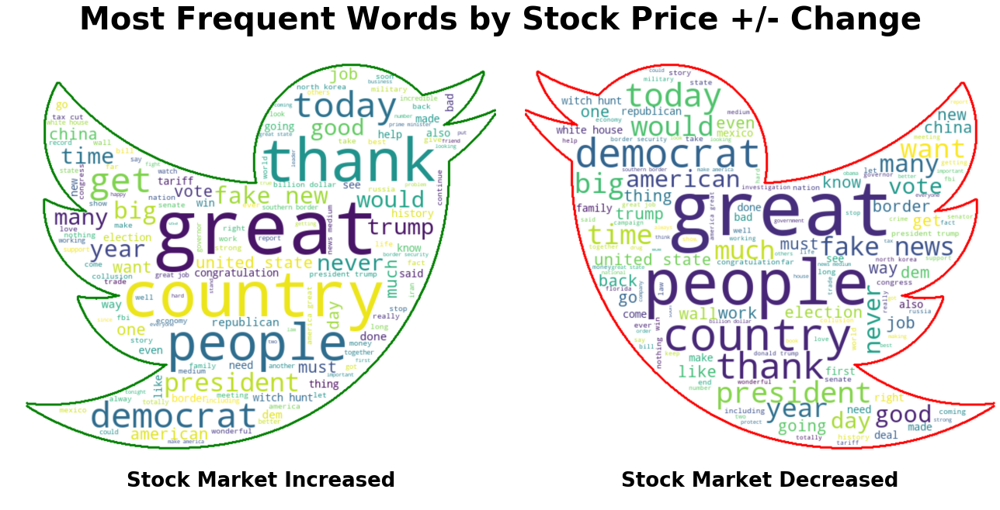

figured saved as figures/wordcloud_top_words_by_delta_price.png


In [43]:

ji.compare_word_clouds(text1=twitter_df_groups['pos']['joined'],
                       label1='Stock Market Increased',
                       text2= twitter_df_groups['neg']['joined'],
                       label2='Stock Market Decreased',
                       twitter_shaped = True, verbose=1,
                       suptitle_y_loc=0.75,
                       suptitle_text='Most Frequent Words by Stock Price +/- Change',
                       wordcloud_cfg_dict={'collocations':True},
                       save_file=True,filepath_folder='',
                       png_filename=file_dict['nlp_figures']['word_clouds_compare'],
                      **{'subplot_titles_fontdict':{'fontsize':26,'fontweight':'bold'},
                        'suptitle_fontdict':{'fontsize':40,'fontweight':'bold'},
                         'group_colors':{'group1':'green','group2':'red'},
                        });

In [44]:
reload(ji)
df_pos_words, df_neg_words = ji.compare_freq_dists_unique_words(text1=twitter_df_groups['pos']['text_tokens'],
                                                                label1='Price Increased',
                                                                text2=twitter_df_groups['neg']['text_tokens'],
                                                                label2='Price Decreased',
                                                                top_n=20, display_dfs=True,
                                                                return_as_dicts=False)

pos_freq_dict, neg_freq_dict = ji.compare_freq_dists_unique_words(text1=twitter_df_groups['pos']['text_tokens'],
                                                                label1='Price Increased',
                                                                text2=twitter_df_groups['neg']['text_tokens'],
                                                                label2='Price Decreased',
                                                                top_n=20, display_dfs=False,
                                                                return_as_dicts=True)


Unique Text1 Words,Frequency
bank,19
mccain,13
con,12
era,12
church,9
wallace,9
nervous,8
nasty,8
closer,8
friendship,8


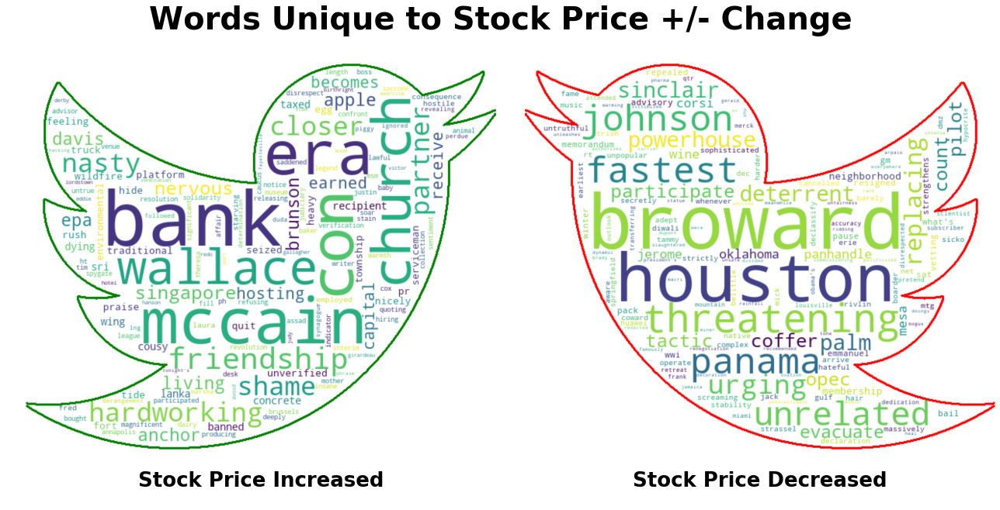

figured saved as figures/wordcloud_unique_words_by_delta_price.png


In [45]:
## WORDCLOUD OF WORDS UNIQUE TO TWEETS THAT INCREASED VS DECREASED STOCK PRICE
ji.reload(ji)

ji.compare_word_clouds(text1= pos_freq_dict,label1='Stock Price Increased',
                       text2=neg_freq_dict, label2='Stock Price Decreased',
                       twitter_shaped=True, from_freq_dicts=True,
                       suptitle_y_loc=0.75,wordcloud_cfg_dict={'collocations':True},
                       suptitle_text='Words Unique to Stock Price +/- Change',
                       save_file=True,filepath_folder='',
                       png_filename=file_dict['nlp_figures']['word_clouds_compare_unique'],
                       **{'subplot_titles_fontdict':
                         {'fontsize':26,
                         'fontweight':'bold'},
                        'suptitle_fontdict':{
                         'fontsize':40,
                         'fontweight':'bold'},
                         'group_colors':{
                             'group1':'green','group2':'red'}
                        });

In [ ]:
reload(ji)
ji.make_tweet_bigrams_by_group(twitter_df_groups)

In [ ]:
# reload([ji])
# patterm =ji.make_regexp_pattern()
# text_data_pos = twitter_df_groups['pos']['df']['cleaned_stopped_content'].apply(lambda x: regexp_tokenize(x,pattern))
# text_data_neg = twitter_df_groups['neg']['df']['cleaned_stopped_content'].apply(lambda x: regexp_tokenize(x,pattern))

# ji.compare_freq_dists(text1=','.join(text_data_pos),
#                        label1='Stock Market Increased',
#                        text2= ','.join(text_data_neg),
#                        label2='Stock Market Decreased',
#                        top_n=25)

In [ ]:
del_me = ['keep_idx', 'df_decomp', 'df_neg_words', 'stock_observed', 'df_pos_words', 'neg_freq_dict', 'stock_residual', 'stock_trend', 'stock_seasonal', 'pos_freq_dict', 'idx_russia_tweets', 'stop_words', 'TEXT', 'my_layout']

for me in del_me:    
    try: 
        exec(f'del {me}')
        print(f'del {me} succeeded')
    except:
        print(f'del {me} succeeded')
        continue


# KERAS NLP CLASSIFICATION

### 💾 [I/O] Stock data loading point 

In [ ]:
## REPLACE THIS CELL WITH USE OF FULL_TWITTER_PROCESSING OR TEXT CLASS
# Import some functions directly
from functions_combined_BEST import ihelp, ihelp_menu, reload


## IMPORT STANDARD PACKAGES
import bs_ds as bs
from bs_ds.imports import *
from pprint import pprint

# Import my custom functions 
import functions_combined_BEST as ji
import my_keras_functions as jik
# Import plotly and cufflinks for iplots
import plotly
import cufflinks as cf
cf.go_offline()


bs.big_pandas()
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

# Reload modules in case files have been updated
reload(ji)

In [ ]:
try:
    twitter_df
except:
    twitter_df= pd.read_csv('assets/data/twitter_df_for_searches.csv',index_col=0,parse_dates=True)
finally:    
    twitter_df = ji.check_twitter_df(twitter_df, text_col='cleaned_stopped_content',
                                 remove_duplicates=True,char_limit=400,
                                 remove_long_strings = True,
                                 show_string_nulls=True)

#     
# twitter_df.dropna(subset=['cleaned_stopped_content'],inplace=True)
# gdf=ji.column_report(twitter_df)

In [ ]:
ji.dict_dropdown(file_dict)

In [ ]:
save_me = False
if save_me:
    fname = file_dict['twitter_df']['twitter_df_pre_stock_price']
    twitter_df.to_csv(fname)
    print(fname)

In [ ]:
ihelp_menu([ji.load_twitter_df_stock_price,ji.load_stock_price_series])

In [ ]:
## Load in twitter data and stock_price in minute resolution
twitter_df = ji.load_twitter_df_stock_price(twitter_df,
                                            get_stock_prices_per_tweet=True,
                                            price_mins_after_tweet=60)                                          

In [ ]:
twitter_df = ji.check_for_duplicated_columns(twitter_df, remove=True)
ji.index_report(twitter_df)
twitter_df.head(2)

In [ ]:
ji.dict_dropdown(file_dict)

In [ ]:
# file_dict['twitter_df']={'twitter_df_pre_stock_price':'data/_twitter_df_before_stock_price.csv',
#                         'twitter_df_post_stock_price':'data/_twitter_df_with_stock_price.csv'}
fname = file_dict['twitter_df']['twitter_df_post_stock_price']
twitter_df.to_csv(fname)
print(fname)

### Word2Vec

In [ ]:
# ##LOAD TWITTER FILE AND CHECK FOR ISSUES 
# reload(ji)
# load_me=True

# if load_me:
#     twitter_df= pd.read_csv(file_dict['twitter_df']['twitter_df_post_stock_price'],index_col=0,parse_dates=True)
#     twitter_df = ji.check_twitter_df(twitter_df, text_col='cleaned_stopped_content',
#                                      remove_duplicates=True,char_limit=400,
#                                      remove_long_strings = True,
#                                      show_string_nulls=True)
# else:
#     ji.check_twitter_df(twitter_df,text_col='content_min_clean',char_limit=400,
#                         remove_duplicates=False, remove_long_strings=False )

In [ ]:
reload(ji)
## Select smaller subset of twitter_df for df_tokenize
columns_for_model_0 = ['delta_price_multiclass','delta_price_class','delta_price','pre_tweet_price',
                       'post_tweet_price','delta_time','B_ts_rounded','B_ts_post_tweet','content',
                       'content_min_clean','cleaned_stopped_content','cleaned_stopped_tokens','delta_price_class_int']

df_tokenize=twitter_df[columns_for_model_0].copy()

# df_tokenize.to_csv('results/_twitter_df_for_model0.csv')

## Create integer version of 'delta_price_class'
# df_tokenize['delta_price_class_int']=df_tokenize['delta_price_class'].apply(lambda x: 1 if x=='pos' else 0) #y = [1 if x=='pos' else 0  for x in df_sampled['delta_price_class']]
display(df_tokenize.head(2))


# print('Class Value Counts -  Before Filtering Out >1 day delta_time')
ji.check_class_balance(df_tokenize, col='delta_price_multiclass',note='')
# ji.check_class_balance(df_tokenize, col='delta_price_class_int',note='')

### [!] Sampling Choices for NLP Models

In [ ]:
## RESAMPLING AND RESTRICTING TIME DELTAS FOR MODEL
remove_delta_time_tweets=False
undersample = False
show_tweet_versions = True

## REMOVE TWEETS BASED ON TIME BETWEEN TWEET AND STOCK PRICE VALUE
if remove_delta_time_tweets:
    ## SAMPLE ONLY TWEETS WITHIN 1 DAY OF STOCK MARKET PRICE DATA
    df_sampled = df_tokenize.loc[df_tokenize['delta_time']<'1 day']
    print(f"# of days removed by 'delta_time' = {df_tokenize.shape[0]-df_sampled.shape[0]}")

    ji.check_class_balance(df_sampled, col='delta_price_multiclass')
else:
    print('[!] Skipping removing tweets by time_delta')
    df_sampled = df_tokenize

## UNDERSAMPLE FROM UNBALANCED CLASSES
if undersample:
    df_sampled = ji.undersample_df_to_match_classes(df_sampled, class_column='delta_price_class_int')
else:
    print('[!] Skipping balancing classes')

if show_tweet_versions:
    ji.display_same_tweet_diff_cols(df_sampled,
                                    columns = ['content' ,'content_min_clean',
                                               'cleaned_stopped_content',
                                               'cleaned_stopped_tokens'],as_md=True) 

In [ ]:
# df_sampled.head()
# y = [int(n) for n in df_sampled['delta_price_multiclass']]
# pd.Series(y).value_counts()

In [ ]:
df_sampled = pd.get_dummies(df_sampled, columns=['delta_price_class'])
df_sampled.head()

In [ ]:
ihelp(ji.make_word2vec_model)

In [ ]:
########################################################################################    
reload(ji)
## FITING WORD2VEC AND TOKENIZER    
text_column='content_min_clean'

## using df_tokenize for full body of a text for word2vec
word2vec_model = ji.make_word2vec_model(df_tokenize,text_column=text_column,
                                   window=3, min_count=2, verbose=1,
                                   return_full=True,**{'sg':1,
                                                       'hs':0,
                                                       'negative':5,
                                                       'ns_exponent':0.75})
w2v_model = word2vec_model.wv
## Get X_sequences and y data
tokenizer, X_sequences = ji.get_tokenizer_and_text_sequences(w2v_model, df_sampled[text_column])
print('X_sequences shape=',X_sequences.shape)
y_int = np.array([int(n) for n in df_sampled['delta_price_multiclass']])
#y = df_sampled['delta_price_class_int'].values
# from keras.utils import to_categorical
# y = to_categorical(y_int)
y=df_sampled[['delta_price_class_neg','delta_price_class_no_change','delta_price_class_pos']].values

## Get training/test split
X_train, X_test, y_train, y_test = ji.train_test_val_split(X_sequences, y, test_size=0.1, val_size=0)

# ji.check_y_class_balance(data=[y_train,y_test])
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)
del X_sequences

# i = np.random.choice(range(len(X_train)))
# back2text = tokenizer.sequences_to_texts(X_train)
# print(X_train[i],'\n')
# print(back2text[i])

# # import pickle
# def pickle_word2vec(word2vec_model, file_dict):
#     filename =  file_dict['word2vec']['base_filename']#'word2vec_model_twitter.pickle'
    
#     filename
    
#     import pickle 
#     with open(filename, 'wb') as f:
#         pickle.dump(word2vec_model,f)
#     file_dict['word2vec']['saved_model'] = filename
#     print(f"[i] word2vec model saved as {filename} ")
#     return file_dict
# file_dict = pickle_word2vec(word2vec_model,file_dict)
#     # with open(filename, 'wb') as f:
#     #     pickle.dump([word_model,vector_size,embedding_matrix],f)

### Model 0: LSTM

In [ ]:
# CREATING CALLBACKS
from keras import callbacks
filepath = 'models/checkpoints/twitterNLP/twitterBLP_model1_weights.ep{epoch:02d}-acc{acc:.2f}.hdf5'
ji.create_required_folders(filepath)

checkpoint = callbacks.ModelCheckpoint(filepath=filepath, monitor='acc',mode='min',
                                       save_best_only=True, verbose=1)
early_stop = callbacks.EarlyStopping(monitor='acc',mode='min',patience=5,min_delta=.001,verbose=2)
callbacks = [checkpoint,early_stop]

## MAKE NLP KERAS MODEL
from keras import models, layers, optimizers, regularizers

model0 = models.Sequential()

## Get and add embedding_layer
embedding_layer = ji.make_keras_embedding_layer(w2v_model, X_train)
model0.add(embedding_layer)
model0.add(layers.SpatialDropout1D(0.2))
# model0.add(layers.LSTM(units=200, return_sequences=True,dropout=0.2,recurrent_dropout=0.3)) #kernel_regularizer=regularizers.l2(.01)))#return_sequences=False))#,
model0.add(layers.LSTM(units=200, return_sequences=False,dropout=0.2, recurrent_dropout=0.2)) 
# model0.add(layers.LSTM(units=100, return_sequences=False))#return_sequences=False))#, kernel_regularizer=regularizers.l2(.01)))

# model0.add(layers.Dense(units=10, activation='relu'))#, activation='tan' # activation='relu'))#removed 08/21

model0.add(layers.Dense(3, activation='softmax'))

model0.compile(loss='categorical_crossentropy',optimizer="adam",metrics=['acc'])#,'val_acc'])#, callbacks=callbacks)
model0.summary()

In [ ]:
reload(ji)
run_me=True
if run_me:
    clock = bs.Clock()
    print('---'*40)
    print('\tFITTING MODEL:')
    print('---'*40,'\n')
    clock.tic('starting keras .fit')

    num_epochs = 10
    history0 = model0.fit(X_train, y_train, epochs=num_epochs,verbose=True, 
                          validation_split=0.2, batch_size=300)#,callbacks=callbacks)#, validation_data=(X_val))
    
    
    clock.toc(f'completed {num_epochs} epochs')
#     ji.evaluate_classification(model0,history0, X_train, X_test,y_train, y_test)

fname = file_dict['model_0A']['fig.ext']
df_class_report0A,fig0A=ji.evaluate_classification(model0,history0,
                                                   X_train, X_test,y_train, y_test, binary_classes=False,
                                                   conf_matrix_classes=['Decrease','No Change','Increase'],
                                                   normalize_conf_matrix=True, 
                                                   save_conf_matrix_png=False,png_filename=fname)#+'.png')
# display(fig0A)

In [ ]:
save_me = False
# ji.reload([jik,ji])
if save_me:
    filename = file_dict['nlp_model_for_predictions']['base_filename']
    nlp_files = ji.save_model_weights_params(model0,check_if_exists=True,auto_increment_name=True, 
                                             auto_filename_suffix=False,filename_prefix=filename)

    file_dict['nlp_model_for_predictions']['output_filenames'] = nlp_files
    update_file_directory(file_dict)
    ji.dict_dropdown(file_dict)


### Model 0B: GRU

In [ ]:
## GRU Model
from keras import models, layers, optimizers, regularizers

model0B = models.Sequential()

## Get and add embedding_layer
embedding_layer = ji.make_keras_embedding_layer(w2v_model, X_train)
model0B.add(embedding_layer)

model0B.add(layers.GRU(units=50, dropout=0.5, recurrent_dropout=0.2,return_sequences=True)) 
model0B.add(layers.GRU(units=50, dropout=0.5, recurrent_dropout=0.2))

# model0.add(layers.Dense(units=50, activation='relu'))#, activation='tan' # activation='relu'))#removed 08/21

model0B.add(layers.Dense(1, activation='sigmoid'))

model0B.compile(loss='categorical_crossentropy',optimizer="adam",metrics=['acc'])#,'val_acc'])#, callbacks=callbacks)
model0B.summary()

In [ ]:
ji.reload(ji)
num_epochs = 5

clock = bs.Clock()
clock.tic()
historyB = model0B.fit(X_train, y_train, epochs=num_epochs, verbose=True, validation_split=0.1,
                     batch_size=300)#callbacks=callbacks,, validation_data=(X_val))
clock.toc()
fname = file_dict['model_0B']['fig.ext']
ji.evaluate_classification(model0B, historyB, 
                           X_train, X_test, y_train,y_test,
                           conf_matrix_classes=['decrease','increase'],
                           normalize_conf_matrix=True,save_conf_matrix_png=True,
                           png_filename=fname
                          )

# ji.evaluate_classification(model0B, historyB, 
#                            X_train, X_test, y_train,y_test,
#                           conf_matrix_classes=None)

In [ ]:
# ji.reload([jik,ji])
filename = file_dict
ji.save_model_weights_params(model0,filename_prefix='models/_twitter_gru100_d1')
# stop

# KERAS STOCK PRICE MODELING

In [ ]:
## cleaning up after modeling
del_me = ['df_tokenize','df_sampled']
for me in del_me:
    try: 
        exec(f'del {me}')
        print(f'del {me} succeeded')
    except:
        print(f'del {me} succeeded')
        continue
        
ji.inspect_variables(locals())

## KERAS MODEL 1: Using only stock `price` alone

In [ ]:
# Display help menu for functions used above
ji.ihelp_menu(function_names=['ji.def_data_params',
              'ji.train_test_split_by_last_days',
              'ji.make_scaler_library',
              'ji.transform_cols_from_library'])

In [ ]:
## IMPORT PACKAGES
from bs_ds.imports import *
import functions_combined_BEST as ji
import my_keras_functions as jik

# Import some functions directly
from functions_combined_BEST import ihelp, ihelp_menu, reload

# Import plotly and cufflinks for iplots
import plotly
import cufflinks as cf
cf.go_offline()

# Reload modules in case files have been updated
reload(jik)
reload(ji)

# Suppress warnings
ji.quiet_mode()
reload(jik)
reload(ji)

#### NOTE ON PARAMETERS TO CHANGE:
- PARAMETERS TO CHANGE ARE LOCATED WITHIN HASHTAG COMMENTED BANNER SECTIONS
    - Header = `######## Name of section to be edited #######`
    - Footer = `#############################################`
    <br><br>
- **For `ji.def_data_params`:**
    - `num_test_days` = number of days left for test dataset
    - `num_train_days` = number of days prior to test_days to use as training dataset
    - `days_for_x_window` = number of days that should be analyzed together (binned for predictions)
    
    
- **For `ji.make_train_test_series_gens`:**
    - `n_features` = number of features/cols to use (for first model, =1, for second model =# of columns)
    - `batch_size` = 1 -  recommendation for timeseries predictions
    
    
- **For `_def_callbacks_and_params_`:**
    - `loss_function` for model checkpoints
    - `patience` = # of epochs without change before early stopping
    - `min_delta` = threshold for change to be considered significant (and therefore counts as new result)
    <br><br>
    
- **For `_def_callbacks_and_params_`:**
    - `loss` = Loss function for training
    -  `metrics` = Metrics to track during fit (['acc','mae'],)
    - `optimizer`= Optimizer to use during compiling ('optimizers.Nadam())

In [ ]:
try:
    stock_df
except: 
    print('loading')
    stock_df = ji.load_processed_stock_data()

In [ ]:
reload([jik,ji])
################# USER PARAMETERS: Define data parameters for train_test_split  ##############
model_params={}
model_params['data_params'] = ji.def_data_params(stock_df,
                                                 num_test_days=5, num_train_days=500, 
                                                 days_for_x_window=1, verbose=0)
###############################################################################################


###### TRAIN TEST SPLIT BY NUMBER OF DAYS ######
dp = model_params['data_params']
df_train, df_test = ji.train_test_split_by_last_days(stock_df,
                                                     periods_per_day = dp['periods_per_day'], 
                                                     num_test_days   =  dp['num_test_days'],
                                                     num_train_days  =  dp['num_train_days'],
                                                     verbose=0, iplot=False)

display(df_train.head(2).style.set_caption('df_train - pre-scaling'))
# ji.display_dict_dropdown(model_params)

###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
scaler_library, df_train, model_params = ji.make_scaler_library(df_train, 
                                                                transform=True,
                                                                model_params=model_params,
                                                                verbose=2)

df_test = ji.transform_cols_from_library(df_test,col_list=None,col_scaler_dict=scaler_library,
                                                      scaler_library=scaler_library,inverse=False)

# Show transformed dataset
display( df_train.head(2).round(3).style.set_caption('training data - scaled'))#,
#         df_test.head(2).round(3).style.set_caption('test data'))



################# USER PARAMETERS: Define n_Features and batch sizes for generators  ##############
# Create timeseries generators
train_generator, test_generator, model_params =\
    ji.make_train_test_series_gens( df_train['price'], df_test['price'],
                                   n_features=1,batch_size=1, model_params=model_params,
                                   verbose=0)
ji.display_dict_dropdown(model_params)
###############################################################################################

# # ji.display_dict_dropdown(model_params)
# funcs_make_model = ['make_train_test_series_gens','def_callbacks_and_params',
#                   'def_compile_params_optimizer','make_model1'] 
# ihelp_menu(funcs_make_model)

In [ ]:
def _def_callbacks_and_params_(model_params=None,loss_function='mae',checkpoint_mode='min',filepath=None,
                             stop_mode='min',patience=1,min_delta=.001,verbose=1):
    import functions_combined_BEST as ji
    

            ########## Define loss function and callback params ##########
    callback_params ={}
    callback_params['custom_loss_function'] = loss_function
    callback_params['ModelCheckpoint'] = {'monitor': loss_function, 'mode':checkpoint_mode}
    callback_params['EarlyStopping'] = {'monitor':loss_function, 'mode':stop_mode, 
                                        'patience':patience, 'min_delta':min_delta}

    # CREATING CALLBACKS
    from keras import callbacks

    if filepath is None:
        filepath = f"models/checkpoints/model1_weights_{ji.auto_filename_time(prefix=None)}.hdf5"

    if 'my_rmse' in loss_function:
        import functions_combined_BEST as ji
        loss_function = ji.my_rmse
#         my_rmse=my_rmse
#         loss_function = my_rmse

    # Create ModelCheckPoint
    fun_params=callback_params['ModelCheckpoint']
    checkpoint = callbacks.ModelCheckpoint(filepath=filepath, monitor=loss_function, mode=fun_params['mode'],
                                           save_best_only=True, verbose=verbose)
    # Create EarlyStopping
    fun_params=callback_params['EarlyStopping']
    early_stop = callbacks.EarlyStopping(monitor=loss_function, mode=fun_params['mode'], patience=fun_params['patience'],
                                         min_delta=fun_params['min_delta'],verbose=verbose)
    callbacks = [checkpoint,early_stop]

    if model_params is None:
        model_params=callback_params
    else:
        model_params['callbacks'] = callback_params
    return callbacks, model_params

################# USER PARAMS: Create ModelCheckpoint and early Stopping callbacks ###################
callbacks, model_params = \
    _def_callbacks_and_params_(model_params, loss_function='my_rmse',
                               checkpoint_mode='min', stop_mode = 'min',
                                patience=1, min_delta=0.001, verbose=1)
######################################################################################################


def _def_compile_params_optimizer_(loss='my_rmse',metrics=['acc','my_rmse'],optimizer='optimizers.Nadam()',model_params=None):
    ####### Specify additional model parameters
    from keras import optimizers
         
    compile_params={}
    compile_params['loss']= loss#{'my_rmse':my_rmse}
    compile_params['metrics'] = metrics#['acc',my_rmse]
    
    if type(optimizer) is str:
        optimizer_name = optimizer
        optimizer = eval(optimizer_name)
    else:
        optimizer_name = optimizer.__class__().__str__()
        
    compile_params['optimizer'] = optimizer
    compile_params['optimizer_name'] = optimizer_name#'optimizers.Nadam()'

    if model_params is not None:
        model_params['compile_params'] = compile_params
    else:
        model_params=compile_params
    
    return model_params


################## Add compiler parameters to model_params ############################
model_params = _def_compile_params_optimizer_(
    loss='my_rmse', 
    metrics=['acc','mae','my_rmse'],
    optimizer='optimizers.Nadam()', 
    model_params=model_params)
########################################################################################
ji.display_dict_dropdown(model_params)

In [ ]:
# Create keras model from model_params
def _make_model1_(model_params, summary=True):
    from keras.models import Sequential
    from keras.layers import Bidirectional, Dense, LSTM, Dropout
    from IPython.display import display
    from keras.regularizers import l2

    # Specifying input shape (size of samples, rank of samples?)
    n_input = model_params['input_params']['n_input']
    n_features = model_params['input_params']['n_features']
    print(f'input shape: ({n_input},{n_features}')
    input_shape=(n_input, n_features)
    
    # Create model architecture
    model = Sequential()
    model.add(LSTM(units=50, input_shape =input_shape,return_sequences=True))#,  kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
#     model.add(Dropout(0.2))
    model.add(LSTM(units=50, activation='relu'))
    model.add(Dense(1))

    # load compile params and compile
    comp_params = model_params['compile_params']
    # metrics = comp_params['metrics']
    loss=comp_params['loss']
    metrics=comp_params['metrics']
    
    if 'my_rmse' in loss or 'my_rmse' in metrics:

        def check_loss_metrics_for_my_rmse(loss,metrics):
            metric_function = metrics
            loss_function = loss
            
            import functions_combined_BEST as ji
            for i,idx in enumerate(metrics):
                if 'my_rmse' in metrics[i]:
                    metric_function[i]=ji.my_rmse
            
            if 'my_rmse' in loss:
                loss_function=ji.my_rmse
                
            return loss_function, metric_function
        
        loss_function,metric_function = check_loss_metrics_for_my_rmse(loss,metrics)
        
    model.compile(loss=loss_function, metrics=metric_function,
                  optimizer=comp_params['optimizer'])##eval(comp_params['optimizer']), metrics=metrics)#optimizer=optimizers.Nadam()
    

    if summary is True:
        display(model.summary())
        
#     if return_params:
#         model_params['compile_params']['loss'] = loss_str
#         model_params['compile_params']['metrics'] = metrics_str
#         return model, model_params
    return model
#########################################################################################

model1=_make_model1_(model_params)

# Display all parameters used to create model
ji.display_dict_dropdown(model_params,title='Parameters for Keras Model')

In [ ]:
def _fit_model_(model,train_generator,model_params=None,epochs=None,callbacks=None,verbose=2,workers=3):
    import bs_ds as bs
    import functions_combined_BEST as ji
    from IPython.display import display

    quiet_command = ji.quiet_mode(True,True,True)
    exec(quiet_command)
    
    if model_params is None:
        model_params={}
    model_params['fit_params'] = {'epochs':epochs}#,'callbacks':callbacks}

    # Instantiating clock timer
    clock = bs.Clock()

    print('---'*20)
    print('\tFITTING MODEL:')
    print('---'*20,'\n')     
    
    # start the timer
    clock.tic('')

    # Fit the model
    fit_params = model_params['fit_params']
    if callbacks is None:
        
        history = model.fit_generator(train_generator,epochs=fit_params['epochs'], 
                                       verbose=2, use_multiprocessing=True, workers=3)
    else:
        
        history = model.fit_generator(train_generator,epochs=fit_params['epochs'],
                                       callbacks=callbacks,
                                       verbose=2,use_multiprocessing=True, workers=3)
    # model_results = model.history.history
    clock.toc('')
    
    return model,model_params,history


#########################################################################################
# Fit keras model to train_generator

model1,model_params,history =_fit_model_(model1,train_generator,
                                          model_params=model_params,
                                          epochs=3,callbacks=callbacks)

# Get results from model.evaluate_generator()
eval_results = ji.evaluate_model_plot_history(model1, train_generator, test_generator)

In [ ]:
# update

### Model 1 Results

In [ ]:
ji.reload([jik,ji])

### PREFER NEW WAY - GET DF_MODEL FIRST THEN GET EVALUATE_REGRESSION INFORMATION?
## Get true vs pred data as a dataframe and iplot
df_model1 = ji.get_model_preds_df(model1, 
                                  test_generator = test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  include_train_data=True,
                                  model_params = model_params,
                                  preds_from_gen = True, 
                                  preds_from_train_preds = True, 
                                  preds_from_test_preds = True,
                                  plot_with_train_data=True,
                                 inverse_tf = True, 
                                  iplot = False)
# display(df_model1.head())
ji.plotly_true_vs_preds_subplots(df_model_preds=df_model1,
                                 true_train_col='true_train_price',
                                 true_test_col='true_test_price',
                                pred_test_columns='pred_from_gen',
                                subplot_mode='lines+markers')
# Get evaluation metrics
regr_evals = ji.get_evaluate_regression_dict(df_model1,
                                             metrics=['r2', 'mae', 'U'],
                                             show_results_df=True, 
                                             return_as_styled_df=True)#return_as_df=True)

In [ ]:
df_dir.set_index('model',inplace=True)

In [ ]:
# Compare predictions if predictions timebins shifted
reload([jik,ji])
df_results1, dfs_results1, df_shifted1 =\
ji.compare_eval_metrics_for_shifts(df_model1['true_test_price'],
                                   df_model1['pred_from_gen'],
                                   shift_list=np.arange(-4,4,1),
                                   true_train_series_to_add=df_model1['true_train_price'],
                                   display_results=True,
                                   display_U_info=False,
                                   return_results=True,
                                   return_styled_df=True,
                                   return_shifted_df=True)

ji.plot_true_vs_preds_subplots(df_model1['true_train_price'],
                               df_model1['true_test_price'],
                               df_model1['pred_from_gen'],
                               save_fig=True,
                               filename =file_dict['model_1']['fig.ext']);
# #SAVING DFS
# save_model_dfs(file_dict,'model_1',
#                df_model=df_model1,
#               df_results=dfs_results1,
#               df_shifted=df_shifted1)

In [ ]:
filename = df_dir.loc[1,'filename']
print(filename)
ji.create_required_folders(filename)
df_model1.to_csv(filename)


In [ ]:
ji.plot_true_vs_preds_subplots(df_model1['true_train_price'], 
                               df_model1['true_test_price'], 
                               df_model1['pred_from_gen'].shift(-1),
                               save_fig=True, filename=file_dict['model_1']['fig_shifted.ext']
                              );


In [ ]:
ji.dict_dropdown(file_dict)

In [ ]:
save_model_dfs(file_dict, 'model_1',df_model1,dfs_results1,df_shifted1)

In [ ]:
save_model=True
filename_prefix = file_dict['model_1']['base_filename']
if save_model ==True:
    model_1_output_files = ji.save_model_weights_params(model1,
                                 model_params=model_params,
                                 filename_prefix=filename_prefix,
                                 auto_increment_name=True,
                                 auto_filename_suffix=True, 
                                 suffix_time_format='%m-%d-%y_%I%M%p',
                                 save_model_layer_config_xlsx=True)
    file_dict['model_1']['output_filenames'] = model_1_output_files

In [ ]:
ji.dict_dropdown(file_dict)

In [ ]:
## SHOW AND EXORT ALL MODEL LAYER CONFIGURATION PARAMS
display_summary = False
if display_summary:
    model_summary_df = ji.make_qgrid_model_menu(model1,return_df=True)
    ji.display_dict_dropdown(model_params)

## KERAS MODEL 2: Using stock price + technical indicators


In [ ]:
ji.inspect_variables(locals())

del_me= ['X_train','X_test','y_train','y_test','df_train','df_test']#list of variable names
for me in del_me:    
    try: 
        exec(f'del {me}')
        print(f'del {me} succeeded')
    except:
        print(f'del {me} succeeded')
        continue

In [ ]:
## IMPORT PACKAGES
from bs_ds.imports import *
import functions_combined_BEST as ji
import my_keras_functions as jik

# Import some functions directly
from functions_combined_BEST import ihelp, ihelp_menu, reload

# Import plotly and cufflinks for iplots
import plotly
import cufflinks as cf
cf.go_offline()

# Reload modules in case files have been updated
reload(jik)
reload(ji)

## check for stock_df
try: stock_df
except NameError:
    stock_df= None
    
if stock_df is None:
    stock_df = ji.load_processed_stock_data()
    
## check for df_train 
try: df_train
except NameError:
    df_train = None
try: df_test
except NameError:
    df_test = None
    
if df_train is None or df_test is None:
    use_prior_train_test_data = False
    print('Training or test data not found')
else:
    use_prior_train_test_data =  True

In [ ]:
stock_df.iplot(y=['MACD','20sd'],theme='solar')

In [ ]:
ji.plotly_technical_indicators(stock_df);

In [ ]:
stock_df = stock_df[[
    'price','ma7','ma21','26ema','12ema','MACD','20sd',
    'upper_band','lower_band','ema','momentum']].copy()#,'filled_timebin'
stock_df.dropna(inplace=True)
stock_df.head()

In [ ]:
use_prior_train_test_data=False
if use_prior_train_test_data == False:
    print('Making new df_train and df_test')
    ################# USER PARAMETERS: Define data parameters for train_test_split  ##############
    model_params={}
    model_params['data_params'] = ji.def_data_params(stock_df,
                                                     num_test_days=5, num_train_days=500, 
                                                     days_for_x_window=1, verbose=0)
    ###############################################################################################


    ###### TRAIN TEST SPLIT BY NUMBER OF DAYS ######
    dp = model_params['data_params']
    df_train, df_test = ji.train_test_split_by_last_days(stock_df,
                                                         periods_per_day = dp['periods_per_day'], 
                                                         num_test_days   =  dp['num_test_days'],
                                                         num_train_days  =  dp['num_train_days'],
                                                         verbose=0, iplot=False)

    display(df_train.head(2).style.set_caption('df_train - pre-scaling'))
    # ji.display_dict_dropdown(model_params)

    ###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
    scaler_library, df_train, model_params = ji.make_scaler_library(df_train, 
                                                                    transform=True,
                                                                    model_params=model_params,
                                                                    verbose=2)

    df_test = ji.transform_cols_from_library(df_test,col_list=None,col_scaler_dict=scaler_library,
                                                          scaler_library=scaler_library,inverse=False)

    # Show transformed dataset
display( df_train.head(2).round(3).style.set_caption('training data - scaled'))#,
    #         df_test.head(2).round(3).style.set_caption('test data'))



################# USER PARAMETERS: Define n_Features and batch sizes for generators  ##############
# Create timeseries generators
train_generator, test_generator, model_params =\
    ji.make_train_test_series_gens(train_data_series=df_train, test_data_series=df_test,y_cols='price',
                                   n_features=len(df_train.columns),batch_size=1, model_params=model_params,
                                   verbose=0)
ji.display_dict_dropdown(model_params)

train_generator[0][0].shape

In [ ]:
###############################################################################################

# # ji.display_dict_dropdown(model_params)
# funcs_make_model = ['make_train_test_series_gens','def_callbacks_and_params',
#                   'def_compile_params_optimizer','make_model1'] 
# ihelp_menu(funcs_make_model)

def _def_callbacks_and_params_(model_params=None,loss_function='mae',checkpoint_mode='min',filepath=None,
                             stop_mode='min',patience=1,min_delta=.005,verbose=1):
    import functions_combined_BEST as ji
    

            ########## Define loss function and callback params ##########
    callback_params ={}
    callback_params['custom_loss_function'] = loss_function
    callback_params['ModelCheckpoint'] = {'monitor': loss_function, 'mode':checkpoint_mode}
    callback_params['EarlyStopping'] = {'monitor':loss_function, 'mode':stop_mode, 
                                        'patience':patience, 'min_delta':min_delta}

    # CREATING CALLBACKS
    from keras import callbacks

    if filepath is None:
        filepath = f"models/checkpoints/model1_weights_{ji.auto_filename_time(prefix=None)}.hdf5"

    if 'my_rmse' in loss_function:
        import functions_combined_BEST as ji
        loss_function = ji.my_rmse
#         my_rmse=my_rmse
#         loss_function = my_rmse

    # Create ModelCheckPoint
    fun_params=callback_params['ModelCheckpoint']
    checkpoint = callbacks.ModelCheckpoint(filepath=filepath, monitor=loss_function, mode=fun_params['mode'],
                                           save_best_only=True, verbose=verbose)
    # Create EarlyStopping
    fun_params=callback_params['EarlyStopping']
    early_stop = callbacks.EarlyStopping(monitor=loss_function, mode=fun_params['mode'], patience=fun_params['patience'],
                                         min_delta=fun_params['min_delta'],verbose=verbose)
    callbacks = [checkpoint,early_stop]

    if model_params is None:
        model_params=callback_params
    else:
        model_params['callbacks'] = callback_params
    return callbacks, model_params

################# USER PARAMS: Create ModelCheckpoint and early Stopping callbacks ###################
callbacks, model_params = \
    _def_callbacks_and_params_(model_params, loss_function='my_rmse',
                               checkpoint_mode='min', stop_mode = 'min',
                                patience=1, min_delta=0.005, verbose=1)
######################################################################################################


def _def_compile_params_optimizer_(loss='my_rmse',metrics=['acc','my_rmse'],optimizer='optimizers.Nadam()',model_params=None):
    ####### Specify additional model parameters
    from keras import optimizers
         
    compile_params={}
    compile_params['loss']= loss#{'my_rmse':my_rmse}
    compile_params['metrics'] = metrics#['acc',my_rmse]
    
    if type(optimizer) is str:
        optimizer_name = optimizer
        optimizer = eval(optimizer_name)
    else:
        optimizer_name = optimizer.__class__().__str__()
        
    compile_params['optimizer'] = optimizer
    compile_params['optimizer_name'] = optimizer_name#'optimizers.Nadam()'

    if model_params is not None:
        model_params['compile_params'] = compile_params
    else:
        model_params=compile_params
    
    return model_params


################## Add compiler parameters to model_params ############################
model_params = _def_compile_params_optimizer_(
    loss='my_rmse', 
    metrics=['my_rmse','mae'],
    optimizer='optimizers.Nadam()', 
    model_params=model_params)
########################################################################################
ji.display_dict_dropdown(model_params)

In [ ]:
# Create keras model from model_params
def _make_model2_(model_params, summary=True):
    import functions_combined_BEST as ji
    from keras.models import Sequential
    from keras.layers import Bidirectional, Dense, LSTM, Dropout
    from IPython.display import display
    from keras.regularizers import l2

    # Specifying input shape (size of samples, rank of samples?)
    n_input = model_params['input_params']['n_input']
    n_features = model_params['input_params']['n_features']
    print(f'input shape: ({n_input},{n_features}')
    input_shape=(n_input, n_features)
    
    # Create model architecture
    model = Sequential()
    model.add(LSTM(units=50, input_shape =input_shape,return_sequences=True))#,  kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
    model.add(Dropout(0.5))
    model.add(LSTM(units=50, activation='relu'))
    model.add(Dense(1))

    # load compile params and compile
    comp_params = model_params['compile_params']
    # metrics = comp_params['metrics']
    loss=comp_params['loss']
    metrics=comp_params['metrics']
    
    if 'my_rmse' in loss or 'my_rmse' in metrics:

        def check_loss_metrics_for_my_rmse(loss,metrics):
            metric_function = metrics
            loss_function = loss
            
            import functions_combined_BEST as ji
            for i,idx in enumerate(metrics):
                if 'my_rmse' in metrics[i]:
                    metric_function[i]=ji.my_rmse
            
            if 'my_rmse' in loss:
                loss_function=ji.my_rmse
                
            return loss_function, metric_function
        
        loss_function,metric_function = check_loss_metrics_for_my_rmse(loss,metrics)
        
    model.compile(loss=loss_function, metrics=metric_function,
                  optimizer=comp_params['optimizer'])##eval(comp_params['optimizer']), metrics=metrics)#optimizer=optimizers.Nadam()
    
    if summary is True:
        display(model.summary())
    return model
#########################################################################################

model2=_make_model2_(model_params)

# Display all parameters used to create model
ji.display_dict_dropdown(model_params,title='Parameters for Keras Model')

In [ ]:
def _fit_model_(model,train_generator,model_params=None,epochs=None,callbacks=None,verbose=2,workers=3):
    import bs_ds as bs
    import functions_combined_BEST as ji
    from IPython.display import display

    quiet_command = ji.quiet_mode(True,True,True)
    exec(quiet_command)
    
    if model_params is None:
        model_params={}
    model_params['fit_params'] = {'epochs':epochs}#,'callbacks':callbacks}

    # Instantiating clock timer
    clock = bs.Clock()
    print('---'*20)
    print('\tFITTING MODEL:')
    print('---'*20,'\n')     
    
    # start the timer
    clock.tic('')

    # Fit the model
    fit_params = model_params['fit_params']
    if callbacks is None:
        
        history = model.fit_generator(train_generator,epochs=fit_params['epochs'], 
                                       verbose=2, use_multiprocessing=True, workers=3)
    else:
        
        history = model.fit_generator(train_generator,epochs=fit_params['epochs'],
                                       callbacks=callbacks,
                                       verbose=2,use_multiprocessing=True, workers=3)
    # model_results = model.history.history
    clock.toc('')
    
    return model,model_params,history


#########################################################################################
# Fit keras model to train_generator

model2,model_params,history =_fit_model_(model2,train_generator,
                                          model_params=model_params,
                                          epochs=5,callbacks=callbacks)

# Get results from model.evaluate_generator()
eval_results = ji.evaluate_model_plot_history(model2, train_generator, test_generator)


#########################################################################################
#########################################################################################

# ji.reload([jik,ji])
### PREFER NEW WAY - GET DF_MODEL FIRST THEN GET EVALUATE_REGRESSION INFORMATION?
## Get true vs pred data as a dataframe and iplot
df_model2 = ji.get_model_preds_df(model2, test_generator=test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  model_params=model_params,
                                  preds_from_gen=True, 
                                  preds_from_train_preds=False, 
                                  preds_from_test_preds=False,
                                  inverse_tf=True,iplot=False)

# Get evaluation metrics
regr_evals = ji.get_evaluate_regression_dict(df_model2,metrics=['r2', 'mae', 'U'],
                                             show_results_df=True, return_as_df=True)

In [ ]:
# display(df_model1.head())
ji.plotly_true_vs_preds_subplots(df_model_preds=df_model2,
                                 true_train_col='true_train_price',
                                 true_test_col='true_test_price',
                                pred_test_columns='pred_from_gen')
display(df_model2.head(2))

### Model 2 Results

In [ ]:
# Compare predictions if predictions timebins shifted
df_results2, dfs_results2, df_shifted2 =\
ji.compare_eval_metrics_for_shifts(df_model2['true_test_price'],
                                   df_model2['pred_from_gen'],
                                   shift_list=np.arange(-4,4,1),
                                   true_train_series_to_add=df_model2['true_train_price'],
                                   display_results=True,
                                   return_styled_df=True,
                                   display_U_info=False,
                                   return_shifted_df=True,
                                   return_results=True)

ji.plot_true_vs_preds_subplots(df_model2['true_train_price'],
                               df_model2['true_test_price'],
                               df_model2['pred_from_gen'], #.shift(-1),
                               save_fig=True,
                               filename =file_dict['model_2']['fig.ext']);
##SAVING DFS
save_model_dfs(file_dict,'model_2',
               df_model=df_model2,
              df_results=dfs_results2,
              df_shifted=df_shifted2)

In [ ]:
df_model2.head()

In [ ]:
filename = df_dir.loc[2,'filename']
print(filename)
ji.create_required_folders(filename)
df_model2.to_csv(filename)


In [ ]:

ji.plot_true_vs_preds_subplots(df_model2['true_train_price'],
                               df_model2['true_test_price'],
                               df_model2['pred_from_gen'].shift(-2),
                               save_fig=True,
                               filename =file_dict['model_2']['fig_shifted']+'_shift-2.png');

In [ ]:
save_model = True
if save_model==True:
    ji.save_model_weights_params(model2,model_params=model_params,
                                 filename_prefix='models/best_stock/model2_U-1_059', auto_increment_name=True,
                                 auto_filename_suffix=True, suffix_time_format='%m-%d-%y_%I%M%p',
                                 save_model_layer_config_xlsx=True)

In [ ]:
ji.dict_dropdown(file_dict)

# KERAS MODEL 3 - Adding Twitter NLP Model Predictions

### IMPORTING NLP TWITTER NEURAL NETWORK Load In NLP Twitter Model

In [ ]:
use_old_model=False

In [ ]:
if use_old_model==True:
    ## LOAD IN TWITTER DF (df_tokenize)
    pd.set_option('display.max_columns',None)
    df_tokenize = pd.read_csv('models/best_twitter/twitter_df_tokenized_with_price.csv',index_col=0, parse_dates=True)
    display(df_tokenize.head(3))

    ## LOAD WORD2VEC MODEL
    filename = 'models/best_twitter/word2vec_model_twitter.pickle'
    import pickle
    with open(filename,'rb') as f:
        word_model,vector_size,embedding_matrix = pickle.load(f)

    # LOAD KERAS TWITTER NLP WORDVEC MODEL AS NOT TRAINABLE
    from keras.models import model_from_json
    with open ('models/best_twitter/bestNLPmodel_best_stock_increase.json','r') as f:
        twitter_model = model_from_json(f.read())
        twitter_model.load_weights('models/best_twitter/bestNLPmodel_best_stock_increase.h5')

    for i, model_layer in enumerate(twitter_model.layers):
        twitter_model.get_layer(index=i).trainable=False
        print(model_layer,twitter_model.get_layer(index=i).trainable)


    display(twitter_model.summary())

    ## DISPLAY MODEL LAYERS' CONFIGURATION
    import function_widgets as fw
    ji.reload([jik,fw,ji])
    ji.make_qgrid_model_menu(twitter_model)

#### ~~LOADING IN TWITTER DATA TO GROUP~~

In [ ]:
# ihelp_menu(['ji.load_raw_twitter_file','ji.full_twitter_df_processing'])
ji.reload([jik,ji])
ji.ihelp(ji.load_raw_twitter_file,show_help=False)
ji.ihelp(ji.full_twitter_df_processing, show_help=False)

#### BOOKMARK - 08/06 - 08/06

In [ ]:
# Import some functions directly
from functions_combined_BEST import ihelp, ihelp_menu, reload


## IMPORT STANDARD PACKAGES
from bs_ds.imports import *
from pprint import pprint

# Import my custom functions 
import functions_combined_BEST as ji
import my_keras_functions as jik
import function_widgets as fw
import bs_ds as bs

# Import plotly and cufflinks for iplots
import plotly
import cufflinks as cf
cf.go_offline()


bs.big_pandas()
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

# Reload modules in case files have been updated
reload(jik)
reload(ji)

In [ ]:
# ## DISPLAY HELP FOR STOCK FUNCTIONS
# ihelp_menu(['ji.load_stock_price_series','ji.load_raw_stock_data_from_txt','ji.set_timeindex_freq',
#            'ji.get_technical_indicators'])

In [ ]:
# ## DISPLAY HELP FOR TWITTER FUNCTIONS
# ihelp_menu(['ji.load_raw_twitter_file',
#             'ji.get_stock_prices_for_twitter_data',
#             'ji.make_time_index_intervals',
#             'ji.bin_df_by_date_intervals',
#             'ji.collapse_df_by_group_index_col',
#             'ji.full_twitter_df_processing'])#,

#### [ OLD ]LOAD IN STOCK DATA

## FINAL WORKING WORKFLOW  🧧 [@NOW ]

1. Load up stock data in CBH form
2. Load up twitter data without NLP
3. Create time_interval_bins ...
    - from *stock CBH* time index
4. Check twitter_df for any tweets from 1_hour prior
5. Extract the 'content' column and retweet/fav counts 

~~Now, compare stock_df and twitter_grouped indices to see if match
- MAYBE I ACTUALLY NEED TO START WITH STOCK_DF AS CBH, THEN PROCESS TWITTER_DF TO MATCH 

- OR:
    - Take `twitter_grouped`'s `time_bin` column as index
    - Use CBH.rollforward(on twitter_grouped.index)
    - Take fill in `STOCK_DF` with the relevant content from `twitter_grouped`
        - `content', etc. 
    - THEN RUN NLP on `content`
    
    

    

In [ ]:
file_dict.keys()
file_dict['model_1']['df_model']

In [ ]:
# Import some functions directly
from functions_combined_BEST import ihelp, ihelp_menu, reload


## IMPORT STANDARD PACKAGES
import bs_ds as bs
from bs_ds.imports import *
from pprint import pprint

# Import my custom functions 
import functions_combined_BEST as ji
import my_keras_functions as jik
import function_widgets as fw


# Import plotly and cufflinks for iplots
import plotly
import cufflinks as cf
cf.go_offline()


bs.big_pandas()
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

# Reload modules in case files have been updated
reload([jik,fw,ji])


# ihelp(stock_df.index, True, False)

In [ ]:
def preview_dict(d, n=5,print_or_menu='print',return_list=False):
    """Previews the first n keys and values from the dict"""
    from pprint import pprint
    list_keys = list(d.keys())
    prev_d = {}
    for key in list_keys[:n]:
        prev_d[key]=d[key]
    
    if 'print' in print_or_menu:
        pprint(prev_d)
    elif 'menu' in print_or_menu:
        ji.display_dict_dropdown(prev_d)
    else:
        raise Exception("print_or_menu must be 'print' or 'menu'")
        
    if return_list:
        out = [(k,v) for k,v in prev_d.items()]
        return out
    else:
        pass


In [ ]:
# ## USE CODE FROM load_Raw_stock_data_from_text
# filename='IVE_bidask1min.txt'
# folderpath='data/'
# start_index = '2016-12-31'
# clean=True
# fill_or_drop_null='drop'
# fill_method='ffill'
# freq='CBH'
# verbose=2


# # Load in the text file and set headers
# fullfilename= folderpath+filename
# headers = ['Date','Time','BidOpen','BidHigh','BidLow','BidClose','AskOpen','AskHigh','AskLow','AskClose']
# stock_df = pd.read_csv(fullfilename, names=headers,parse_dates=True)

# # Create datetime index
# date_time_index = (stock_df['Date']+' '+stock_df['Time']).rename('date_time_index')
# stock_df['date_time_index'] = pd.to_datetime(date_time_index)
# stock_df.set_index('date_time_index', inplace=True, drop=False)

# # Select only the days after start_index
# stock_df = stock_df[start_index:]
# stock_df.head()

### 🧧BOOKMARK Load full stock data, unprocessed raw tweets

In [ ]:
ji.dict_dropdown(file_dict)
fname = file_dict['stock_df']['stock_df_with_indicators']

fname

In [ ]:
# LOAD IN FULL STOCK DATASET using ClosingBig S&P500 WITH INDEX.FREQ=CBH
reload(ji)
fname = file_dict['stock_df']['stock_df_with_indicators']
full_df = ji.load_processed_stock_data(processed_data_filename=fname)

# SELECT DESIRED COLUMNS
stock_df = full_df[[
    'price','ma7','ma21','26ema','12ema','MACD',
    '20sd','upper_band','lower_band','ema','momentum','filled_timebin'
]]

stock_df.head()

stock_df['date_time'] = stock_df.index.to_series()
ji.index_report(stock_df)

stock_df.sort_index(inplace=True)
display(stock_df.head(2),stock_df.tail(2))


In [ ]:
## LOAD IN RAW TWITTER DATA, NO PROCESSING
reload(ji)
twitter_df= ji.load_raw_twitter_file(filename='data/trumptwitterarchive_export_iphone_only__08_23_2019.csv',
                                     date_as_index=True,
                                     rename_map={'text': 'content', 'created_at': 'date'})
twitter_df = ji.check_twitter_df(twitter_df,text_col='content',remove_duplicates=True, remove_long_strings=True)
# twitter_df.sort_index(inplace=True)
# ji.index_report(twitter_df)
# twitter_df.head(3)

In [ ]:
ihelp_menu(['ji.make_time_index_intervals'])


#### and now...
- have int_bins for both dataframes.
- want to bin all of the data using `int_bins` (Even tho `int_bins` is for 24 hours, not BUSINESS HOURS)
    - use the `collapse_df_by_group_index_col` function on BOTH df's first
    - then concat/merge/join
    

In [ ]:
# MAKE TIME INTERVALS BASED ON BUSINESS HOUR START (09:30-10:30)
ji.reload(ji)
clock = bs.Clock(verbose=1)

clock.tic()
time_intervals= \
ji.make_time_index_intervals(stock_df,
                             col='date_time', 
                             closed='right',
                             return_interval_dicts=False) 
clock.lap('time_intervals created.')


## USE THE TIME INDEX TO FILTER OUT TWEETS FROM THE HOUR PRIOR
twitter_df, bin_codes = ji.bin_df_by_date_intervals(twitter_df ,time_intervals)
stock_df, bin_codes_stock = ji.bin_df_by_date_intervals(stock_df, time_intervals, column='date_time')

clock.lap('bins added to dataframes')
# display(twitter_df.head(2), stock_df.head(2))

## COLLAPSE DFs BY CODED BINS
twitter_grouped = ji.collapse_df_by_group_index_col(twitter_df,
                                                    group_index_col='int_bins',
                                                    drop_orig=True,
                                                    verbose=0)

stocks_grouped = ji.collapse_df_by_group_index_col(stock_df,
                                                    drop_orig=True,
                                                    group_index_col='int_bins', 
                                                  verbose=0)

clock.toc('collapsed dfs to _grouped')
display(twitter_grouped.head(3),stocks_grouped.head(3))

In [ ]:
def merge_stocks_and_tweets(stocks_grouped,twitter_grouped, on='int_bins',how='left', show_summary=True):
    """Takes stocks_grouped and twitter_grouped dataframes grouped by hour bins, merges
    them on the 'int_bins' columns."""
    def fix_tweet_times(x):
        time_format="%Y-%m-%d %T"
        if isinstance(x,pd.Timestamp) | isinstance(x,pd.DatetimeIndex):
            return x.strftime(time_format)

        elif  isinstance(x,list) |  isinstance(x,np.ndarray):
            ts = [pd.to_datetime(t,format=time_format) for t in x] 
    #         ts = [t.strftime(time_format) for t in x]#ts]
            return ts

        elif pd.isnull(x): 
    #         print('null')
            return x

        else: 
            ts= pd.to_datetime(str(x)) 
            timestring = ts.strftime(time_format)        #x.strftime(time_format)
            return timestring

    ## MERGE DATAFRAMES
    df_combined = pd.merge(stocks_grouped,twitter_grouped, on='int_bins',how='left')#,indicator=True)

    ## ADDING COLUMNS TO WEED THROUGH MISSING DATA FROM MERGER
    df_combined['has_tweets'] = ~df_combined['group_content'].isna()
    df_combined['has_stocks'] = ~df_combined['price'].isna()
    df_combined['has_both'] =(df_combined['has_tweets']==True) & (df_combined['has_stocks']==True)# 


    ## CLEAN UP DATAFRAME
    # Drop redundant cols
    drop_cols = ['date','int_times_y','time_bin_y','time_bin_x','num_per_bin_x']
    df_combined.drop(drop_cols,axis=1,inplace=True)

    # Rename distinct stock vs tweet columns
    rename_map = {'date_time_index_y':'tweet_times',
                 'date_time_index_x':'stock_times',
                  'int_times_x':'int_times',
                  'num_per_bin_y':'num_tweets',
                  'int_times_x':'int_tweets_for_stocks'
                 }
    df_combined  = df_combined.rename(axis=1,mapper=rename_map)

    ## Add fixed ts for tweet_times
    df_combined['tweet_times'] = df_combined['tweet_times'].apply(lambda x: fix_tweet_times(x))

    df_combined.set_index('date_time', inplace=True,drop=False)
    
    if show_summary:
        n=3
        display(df_combined.groupby('has_both').head(3))
        display(df_combined.loc[ df_combined['num_tweets']>1].head(n))
    return df_combined

## STOCKS AND TWEETS 
df_combined = merge_stocks_and_tweets(stocks_grouped, 
                                      twitter_grouped,
                                      on='int_bins',how='left',
                                      show_summary=True)

In [ ]:
ji.dict_dropdown(file_dict)

In [ ]:
file_dict['file_directory'] = 'assets/filename_directory.json'

with open(file_dict['file_directory'], 'w') as f:
    import json
    json_file = json.dumps(file_dict)
    f.write(json_file)
    print(f"{file_dict['file_directory']} saved successfully.")
    

In [ ]:
# def fix_tweet_times(x):
#     time_format="%Y-%m-%d %T"
#     import datetime as dt
#     import dateutil

#     if isinstance(x,pd.Timestamp) | isinstance(x,pd.DatetimeIndex):
# #         print('Was timestamp or datetimeindex')#type(x))
#         return x.strftime(time_format)

#     elif pd.isnull(x):
#         return x

#     elif  isinstance(x,list) |  isinstance(x,np.ndarray):
# #         ts = pd.to_datetime(x)
#         ts = [t.strftime(time_format) for t in x]#ts]
#         return ts
#     else:
#         return np.nan
# #
    
# df_combined['test_tweet_times'] = df_combined['tweet_times'].apply(lambda x: fix_tweet_times(x))
# df_combined[['has_both','test_tweet_times']].groupby('has_both').head()

#### ~~BOOKMARK - DF READY FOR NLP - >MODELING~~

In [ ]:
## Open file firectory 
with open('assets/filename_directory.json', 'r+') as f:
    import json
    file_dict_json = f.read()
    file_dict_test = json.loads(file_dict_json)
    

In [ ]:
ji.dict_dropdown(file_dict_test)

In [ ]:
file_dict_test['model_1']['df_model']

In [ ]:
fname = file_dict['df_combined']['pre_nlp']
df_combined.to_csv(fname)#,index_col=0,parse_dates=True)
df_combined = pd.read_csv(fname,index_col=0,parse_dates=True)
df_combined.groupby('has_both').head(2)

In [ ]:
df_combined['group_content'].fillna("",inplace=True)

df_nlp = ji.full_twitter_df_processing(df_combined,'group_content',force=True)

def quick_fix_text(x):
    if x == 'nan':
        return ""
    elif isinstance(x,list):
        if len(x)==0:
            return ""
        
for col in ['content_min_clean','content_cleaned_stop','content_cleaned_stop_tokens']:
    df_nlp[col].fillna("",inplace=True)
    df_nlp[col].apply(lambda x: quick_fix_text(x))
    
display(df_nlp.head())
# ji.column_report(df_nlp)

In [ ]:
ji.display_same_tweet_diff_cols(df_nlp,columns= ['content_min_clean','content_cleaned_stop','content_cleaned_stop_tokens'],
                                as_md=True)

In [ ]:
ji.check_twitter_df(df_nlp,char_limit=61*350)


get_floats = df_nlp['content_min_clean'].apply(lambda x: isinstance(x,float))
display(get_floats.value_counts())

df_nlp = df_nlp[~get_floats]
df_nlp.head()


In [ ]:
fname = file_dict['df_combined']['post_nlp']
df_nlp.to_csv(fname)#,index_col=0,parse_dates=True)
df_nlp = pd.read_csv(fname,index_col=0,parse_dates=True)
df_nlp.groupby('has_both').head(2)

### Load in former NLP model and change embedding_layer size

In [ ]:
# ## LOAD IN TWITTER DF (df_tokenize)
# pd.set_option('display.max_columns',None)
# df_tokenize = pd.read_csv('models/best_twitter/twitter_df_tokenized_with_price.csv',index_col=0, parse_dates=True)
# display(df_tokenize.head(3))

# ## LOAD WORD2VEC MODEL
# filename = 'models/best_twitter/word2vec_model_twitter.pickle'
# import pickle
# with open(filename,'rb') as f:
#     word_model,vector_size,embedding_matrix = pickle.load(f)

# # LOAD KERAS TWITTER NLP WORDVEC MODEL AS NOT TRAINABLE
# from keras.models import model_from_json
# with open ('models/best_twitter/bestNLPmodel_best_stock_increase.json','r') as f:
#     twitter_model = model_from_json(f.read())
#     twitter_model.load_weights('models/best_twitter/bestNLPmodel_best_stock_increase.h5')
    
# for i, model_layer in enumerate(twitter_model.layers):
#     twitter_model.get_layer(index=i).trainable=False
#     print(model_layer,twitter_model.get_layer(index=i).trainable)
    
    

In [ ]:
# ji.reload([jic,ji])

# ## LOAD WORD2VEC MODEL
# filename = 'models/best_twitter/word2vec_model_twitter.pickle'
# import pickle
# with open(filename,'rb') as f:
#     word_model,vector_size,embedding_matrix = pickle.load(f)

# TEXT = ji.TEXT(df_combined,'content_stop',text_labels_col=None,word2vec_model=word_model)
# # txt.x

In [ ]:
ji.dict_dropdown(file_dict)

In [ ]:
# LOAD KERAS TWITTER NLP WORDVEC MODEL AS NOT TRAINABLE
from keras.models import model_from_json
fname = file_dict['nlp_model_for_predictions']['output_filenames']['model']+'.json'
weight_name = file_dict['nlp_model_for_predictions']['output_filenames']['weights']

with open (fname,'r') as f: 
    
    import json
    json_model = json.loads(f.read())
    twitter_model = model_from_json(json_model)#f.read())
    twitter_model.load_weights(weight_name) #'models/best_twitter/bestNLPmodel_best_stock_increase.h5')
    
for i, model_layer in enumerate(twitter_model.layers):
    
    twitter_model.get_layer(index=i).trainable=False
    print(model_layer,twitter_model.get_layer(index=i).trainable)

display(twitter_model.summary())

In [ ]:
w2v_file = file_dict['word2vec']['saved_model']
with open(w2v_file,'rb') as f:
    import pickle
    word_model = pickle.load(f)
    print('word_model imported')
    print(f'{len(word_model.wv.vocab)} words in vocab')

## DISPLAY MODEL LAYERS' CONFIGURATION
# import function_widgets as fw
# ji.reload([jik,fw,jic,ji])
# ji.make_qgrid_model_menu(twitter_model)

### Get predictions for hour-binned tweets

In [ ]:
df_nlp.head(2)

In [ ]:
ihelp(ji.replace_embedding_layer)

In [ ]:
## GET X_SEQUENES FOR BINNED TWEETS AND CREATE NEW EMBEDDING LAYER FOR THEIR SIZE
reload(ji)
text_data=df_nlp['content_min_cleaan']
tokenizer, X_sequences = ji.get_tokenizer_and_text_sequences(word_model,text_data)

new_twitter_model = ji.replace_embedding_layer(twitter_model,word_model,text_data,verbose=2)
new_twitter_model.summary()

In [ ]:
## GET PREDICTIONS FROM NEW MODEL
preds = new_twitter_model.predict_classes(X_sequences)
print(type(preds), preds.shape)

In [ ]:
df_nlp['pred_classes'] = preds
display(df_nlp.head())

In [ ]:
ji.display_same_tweet_diff_cols(df_combined,index='08-23-2019',columns=['content_min_clean'],as_md=True)

In [ ]:
df_combined.head()

In [ ]:
print(df_nlp['pred_classes'].value_counts(),
df_nlp['has_tweets'].value_counts())
# del preds

In [ ]:
fname = file_dict['df_combined']['with_preds']
df_nlp.to_csv(fname)
print(fname)

# KERAS MODEL 3 (for real):

## BOOKMARK - NOW THAT HAVE PREDICTIONS FOR EACH HOUR, MAKE NEW STOCK MODEL

In [ ]:
ji.dict_dropdown(file_dict)

In [ ]:
ji.index_report(df_nlp)

In [ ]:
del df_combined

In [ ]:
# df_combined.to_csv('df_combined_ready_model3.csv')#,index_col=0,parse_dates=True)
try: 
    df_combined
except NameError:
    fname = file_dict['df_combined']['with_preds']
    df_combined = pd.read_csv(fname,index_col=0,parse_dates=True)
    
# df_combined_ = pd.read_csv('df_combined_ready_model3.csv',index_col=0,parse_dates=True)
df_combined.groupby('has_both').head(2)

In [ ]:
## Pick columns to use
df = ji.column_report(df_combined, show_and_return=False,as_df=True)
# df = qdf.get_changed_df()

model_col_list = ['price', 'ma7', 'ma21', '26ema', '12ema', 'MACD', '20sd', 'upper_band','lower_band', 'ema', 'momentum',
                  'num_tweets','case_ratio', 'compound_score','pos','neu','neg','sentiment_class','pred_classes',
                 'total_favorite_count','total_retweet_count']
df.set_index('column name',inplace=True)
df.loc[model_col_list,'Notes'] = 'Y'

import qgrid
qgrid.show_grid(df)

In [ ]:
## Make a list of all columns to be used in training the model
df_to_model = df_combined[model_col_list].copy()

print(df_to_model['price'].isna().sum())
df_to_model.head()

df_to_model.

In [ ]:
reload(ji)

In [ ]:
df_to_model2 = ji.set_timeindex_freq(df_to_model,freq='CBH',fill_nulls=True,fill_with_val_or_method='val',fill_val=0)
# print(df_to_model['price'].isna().sum())
df_to_model2.head()

df_to_model = df_to_model2.copy()

In [ ]:
ji.dict_dropdown(file_dict)
# df_combined.to_csv('data/_df_combined_final_check_pre_model3.csv')

In [ ]:
# ji.inspect_variables(locals(),top_n=10,print_names=True)
# ## CODE TO DELETE MANY VARS AT ONCE:

# del_me= ['X_sequences',  'df_nlp', 'df_nlp_', 'df_combined_', 'text_data', 'bin_codes_stock']#list of variable names
# for me in del_me:    
#     try: 
#         exec(f'del {me}')
#         print(f'del {me} succeeded')
#     except:
#         print(f'del {me} succeeded')
#         continue

In [ ]:
from pandas_profiling import ProfileReport
# ProfileReport(df_to_model)
qdf = ji.column_report(df_to_model)

In [ ]:
mapper = {'neg':0,'pos':1}
df_to_model['sentiment_codes'] = df_to_model['sentiment_class'].map(mapper)
df_to_model.drop('sentiment_class',axis=1,inplace=True)
df_to_model.head()

In [ ]:
df_to_model.loc[df_to_model['price']==0] = np.nan
df_to_model.dropna(subset=['price'], inplace=True)

df_to_model.head()

In [ ]:
ji.column_report(df_to_model);

In [ ]:
# df_to_model__ = df_to_model.copy()

In [ ]:
# df_to_model.to_csv('data/_df_to_model_final.csv')
ji.index_report(df_to_model)
df_to_model = ji.set_timeindex_freq(df_to_model)
# df_to_model.index.freq=ji.custom_BH_freq()
ji.index_report(df_to_model)

In [ ]:
qdf = ji.column_report(df_to_model)

In [ ]:
use_prior_train_test_data=False
## To do:
# list_of_days_for_x_windows for parameter tuning

list_of_columns_to_remove = ['filled_timebin','compound_score']
if use_prior_train_test_data == False:
    print('Making new df_train and df_test')
    
    ################# USER PARAMETERS: Define data parameters for train_test_split  ##############
    model_params={}
    model_params['data_params'] = ji.def_data_params(df_to_model.drop(list_of_columns_to_remove,axis=1),
                                                     num_test_days=10, num_train_days=365, 
                                                     days_for_x_window=1, verbose=0)
    ###############################################################################################


    ###### TRAIN TEST SPLIT BY NUMBER OF DAYS ######
    dp = model_params['data_params']
    df_train, df_test = ji.train_test_split_by_last_days(df_to_model,
                                                         periods_per_day = dp['periods_per_day'], 
                                                         num_test_days   =  dp['num_test_days'],
                                                         num_train_days  =  dp['num_train_days'],
                                                         verbose=0, iplot=False)

    display(df_train.head(2).style.set_caption('df_train - pre-scaling'))
    # ji.display_dict_dropdown(model_params)

    ###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
    scaler_library, df_train, model_params = ji.make_scaler_library(df_train, 
                                                                    transform=True,
                                                                    model_params=model_params,
                                                                    verbose=2)

    df_test = ji.transform_cols_from_library(df_test,col_list=None,col_scaler_dict=scaler_library,
                                                          scaler_library=scaler_library,inverse=False)

# Show transformed dataset
display( df_train.head(2).round(3).style.set_caption('training data - scaled'))#,
    #         df_test.head(2).round(3).style.set_caption('test data'))



################# USER PARAMETERS: Define n_Features and batch sizes for generators  ##############
# Create timeseries generators
train_generator, test_generator, model_params =\
    ji.make_train_test_series_gens(train_data_series=df_train, test_data_series=df_test,y_cols='price',
                                   n_features=len(df_train.columns),batch_size=1, model_params=model_params,
                                   verbose=1)
ji.display_dict_dropdown(model_params)

train_generator[0][0].shape

In [ ]:
###############################################################################################

# # ji.display_dict_dropdown(model_params)
# funcs_make_model = ['make_train_test_series_gens','def_callbacks_and_params',
#                   'def_compile_params_optimizer','make_model1'] 
# ihelp_menu(funcs_make_model)

def _def_callbacks_and_params_(model_params=None,loss_function='my_rmse',checkpoint_mode='min',filepath=None,
                             stop_mode='min',patience=1,min_delta=.005,verbose=1):
    import functions_combined_BEST as ji
    

            ########## Define loss function and callback params ##########
    callback_params ={}
    callback_params['custom_loss_function'] = loss_function
    callback_params['ModelCheckpoint'] = {'monitor': loss_function, 'mode':checkpoint_mode}
    callback_params['EarlyStopping'] = {'monitor':loss_function, 'mode':stop_mode, 
                                        'patience':patience, 'min_delta':min_delta}

    # CREATING CALLBACKS
    from keras import callbacks

    if filepath is None:
        filepath = f"models/checkpoints/model1_weights_{ji.auto_filename_time(prefix=None)}.hdf5"

    if 'my_rmse' in loss_function:
        import functions_combined_BEST as ji
        loss_function = ji.my_rmse
#         my_rmse=my_rmse
#         loss_function = my_rmse

    # Create ModelCheckPoint
    fun_params=callback_params['ModelCheckpoint']
    checkpoint = callbacks.ModelCheckpoint(filepath=filepath, monitor=loss_function, mode=fun_params['mode'],
                                           save_best_only=True, verbose=verbose)
    # Create EarlyStopping
    fun_params=callback_params['EarlyStopping']
    early_stop = callbacks.EarlyStopping(monitor=loss_function, mode=fun_params['mode'], patience=fun_params['patience'],
                                         min_delta=fun_params['min_delta'],verbose=verbose)
    callbacks = [checkpoint,early_stop]

    if model_params is None:
        model_params=callback_params
    else:
        model_params['callbacks'] = callback_params
    return callbacks, model_params

################# USER PARAMS: Create ModelCheckpoint and early Stopping callbacks ###################
callbacks, model_params = \
    _def_callbacks_and_params_(model_params, loss_function='my_rmse',
                               checkpoint_mode='min', stop_mode = 'min',
                                patience=1, min_delta=0.005, verbose=1)
######################################################################################################


def _def_compile_params_optimizer_(loss='my_rmse',metrics=['acc','my_rmse'],optimizer='optimizers.Nadam()',model_params=None):
    ####### Specify additional model parameters
    from keras import optimizers
         
    compile_params={}
    compile_params['loss']= loss#{'my_rmse':my_rmse}
    compile_params['metrics'] = metrics#['acc',my_rmse]
    
    if type(optimizer) is str:
        optimizer_name = optimizer
        optimizer = eval(optimizer_name)
    else:
        optimizer_name = optimizer.__class__().__str__()
        
    compile_params['optimizer'] = optimizer
    compile_params['optimizer_name'] = optimizer_name#'optimizers.Nadam()'

    if model_params is not None:
        model_params['compile_params'] = compile_params
    else:
        model_params=compile_params
    
    return model_params


################## Add compiler parameters to model_params ############################
model_params = _def_compile_params_optimizer_(
    loss='my_rmse', 
    metrics=['acc','mae'],
    optimizer='optimizers.Nadam()', 
    model_params=model_params)
########################################################################################
ji.display_dict_dropdown(model_params)

# Create keras model from model_params
def _make_model4_(model_params, summary=True):
    from keras.models import Sequential
    from keras.layers import Bidirectional, Dense, LSTM, Dropout
    from IPython.display import display
    from keras.regularizers import l2

    # Specifying input shape (size of samples, rank of samples?)
    n_input = model_params['input_params']['n_input']
    n_features = model_params['input_params']['n_features']
    print(f'input shape: ({n_input},{n_features}')
    input_shape=(n_input, n_features)
    
    # Create model architecture
    model = Sequential()
    model.add(LSTM(units=50, input_shape =input_shape,return_sequences=True,))#,  kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
    model.add(Dropout(0.2))
    model.add(LSTM(units=50, activation='relu'))
#     model.add(Dense(units=10, activation='relu'))
    model.add(Dense(1))

    # load compile params and compile
    comp_params = model_params['compile_params']
    # metrics = comp_params['metrics']
    loss=comp_params['loss']
    metrics=comp_params['metrics']
    
    if 'my_rmse' in loss or 'my_rmse' in metrics:

        def check_loss_metrics_for_my_rmse(loss,metrics):
            metric_function = metrics
            loss_function = loss
            
            import functions_combined_BEST as ji
            for i,idx in enumerate(metrics):
                if 'my_rmse' in metrics[i]:
                    metric_function[i]=ji.my_rmse
            
            if 'my_rmse' in loss:
                loss_function=ji.my_rmse
                
            return loss_function, metric_function
        
        loss_function,metric_function = check_loss_metrics_for_my_rmse(loss,metrics)
        
    model.compile(loss=loss_function, metrics=metric_function,
                  optimizer=comp_params['optimizer'])##eval(comp_params['optimizer']), metrics=metrics)#optimizer=optimizers.Nadam()
    

    if summary is True:
        display(model.summary())
        
#     if return_params:
#         model_params['compile_params']['loss'] = loss_str
#         model_params['compile_params']['metrics'] = metrics_str
#         return model, model_params
    return model
#########################################################################################

model4=_make_model4_(model_params)

# Display all parameters used to create model
ji.display_dict_dropdown(model_params,title='Parameters for Keras Model')

In [ ]:
def _fit_model_(model,train_generator,model_params=None,epochs=None,callbacks=None,verbose=2,workers=3):
    import bs_ds as bs
    import functions_combined_BEST as ji
    from IPython.display import display

    quiet_command = ji.quiet_mode(True,True,True)
    exec(quiet_command)
    
    if model_params is None:
        model_params={}
    model_params['fit_params'] = {'epochs':epochs}#,'callbacks':callbacks}

    # Instantiating clock timer
    clock = bs.Clock()

    print('---'*20)
    print('\tFITTING MODEL:')
    print('---'*20,'\n')     
    
    # start the timer
    clock.tic('')

    # Fit the model
    fit_params = model_params['fit_params']
    if callbacks is None:
        
        history = model.fit_generator(train_generator,epochs=fit_params['epochs'], 
                                       verbose=2, use_multiprocessing=True, workers=3)
    else:
        
        history = model.fit_generator(train_generator,epochs=fit_params['epochs'],
                                       callbacks=callbacks,
                                       verbose=2,use_multiprocessing=True, workers=3)
    # model_results = model.history.history
    clock.toc('')
    
    return model,model_params,history


#########################################################################################
# Fit keras model to train_generator

model4,model_params,history =_fit_model_(model4,train_generator,
                                          model_params=model_params,
                                          epochs=4,callbacks=callbacks)


# Get results from model.evaluate_generator()
eval_results = ji.evaluate_model_plot_history(model4, train_generator, test_generator)


### Model 3 Results

In [ ]:
#########################################################################################
#########################################################################################

# ji.reload([jik,ji])
### PREFER NEW WAY - GET DF_MODEL FIRST THEN GET EVALUATE_REGRESSION INFORMATION?
## Get true vs pred data as a dataframe and iplot
df_model4 = ji.get_model_preds_df(model4, test_generator=test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  model_params=model_params,
                                  preds_from_gen=True, 
                                  preds_from_train_preds=False, 
                                  preds_from_test_preds=False,
                                  inverse_tf=True,iplot=False)

# Get evaluation metrics
regr_evals = ji.get_evaluate_regression_dict(df_model4,metrics=['r2', 'mae', 'U'],
                                             show_results_df=True, return_as_df=True)

In [ ]:
ji.plotly_true_vs_preds_subplots(df_model_preds=df_model4,
                                 true_train_col='true_train_price',
                                 true_test_col='true_test_price',
                                pred_test_columns='pred_from_gen')
ji.disp_df_head_tail(df_model4)

In [ ]:
# Compare predictions if predictions timebins shifted
df_results4, dfs_results4, df_shifted4 =\
ji.compare_eval_metrics_for_shifts(df_model4['true_test_price'],
                                   df_model4['pred_from_gen'],
                                   shift_list=np.arange(-4,4,1),
                                   true_train_series_to_add=df_model4['true_train_price'],
                                   display_results=True, 
                                   display_U_info=False,
                                   return_styled_df=True,
                                   return_shifted_df=True,
                                   return_results=True)

ji.plot_true_vs_preds_subplots(df_model4['true_train_price'],
                               df_model4['true_test_price'],
                               df_model4['pred_from_gen'],
                               subplots=True,save_fig=True,
                               filename=file_dict['model_3']['fig.ext']);

In [ ]:

ji.plot_true_vs_preds_subplots(df_model4['true_train_price'],
                               df_model4['true_test_price'],
                               df_model4['pred_from_gen'].shift(-2),
                               subplots=True,save_fig=True,
                               filename=file_dict['model_3']['fig_shifted.ext']);

In [ ]:
save_model_dfs(file_dict,'model_3',
               df_model=df_model4,
               df_results=dfs_results4,
               df_shifted=df_shifted4)

In [ ]:
ji.dict_dropdown(file_dict)

In [ ]:
ji.reload([jik,ji])
save_model = True
fname = 
if save_model==True:
    ji.save_model_weights_params(model4,model_params=model_params,
                                 filename_prefix='models/model4_', 
                                 filename_suffix='_BEST_u_val_666',
                                 auto_increment_name=True,auto_filename_suffix=True,
                                 suffix_time_format='%m-%d-%y_%I%M%p',
                                 save_model_layer_config_xlsx=True)

# Reviewing Results / Summary

In [ ]:
res_dict = {}
for model in ['model_1','model_2','model_3']:
    fname = file_dict[model]['df_results'].replace('.csv','.xlsx')
    res_df = pd.read_excel(fname,index_col=0)
#     res_dfs = ji.color_cols(res_df, subset=['R^2'],rev=False)
    res_dict[model] = res_df#pd.read_excel(fname,index_col=0)
    
ji.display_df_dict_dropdown(res_dict);

In [ ]:
ji.dict_dropdown(file_dict)

In [ ]:
preds_dict = {}
# import matplotlib.image as mpimg 
# import matplotlib.pyplot as plt 
# from PIL import Image

for model in ['model_1','model_2','model_3']:
    
    fname = file_dict[model]['df_model']
    preds_df = pd.read_csv(fname,index_col=0,parse_dates=True)
    
    preds_dict[model]=preds_df
    
    
for k,df in preds_dict.items():
    print(df.columns)
    ji.plotly_true_vs_preds_subplots(df, true_train_col= 'true_train_price',
                                     true_test_col= 'true_test_price',
                                     pred_test_columns=
#     )

## 🧧BOOKMARK🧧 EXPORTING RESULTS

In [ ]:
table_styles = [dict(selector='td,body',props=[('border','1px solid black'),
                                         ('border-collapse','collapse')]),
                 dict(selector='td:nth-child(1)', props=[('font-weight','bold')]),
                dict(selector='th',props=[('border','1px solid black'),
                                         ('border-collapse','collapse')]),                
                dict(selector='tr :nth-child(:even)',props=[('background-color','blue')])
                ]

# dfs_results1.set_table_styles(table_styles) 

html_df = dfs_results1.set_table_styles(table_styles).render()
with open('results/model_1_time_shifted_results_to_test_1.html','w') as file:
    file.write(html_df)
    

from IPython.display import HTML
HTML(html_df)

In [ ]:
HTML(df_results.to_html(index=False))
df2png(df_results.to_html(index=False))

In [ ]:
# table_css = """
table.dataframe{
    border: 1px solid black;
    
                                         ('border-collapse','collapse')]),
                 dict(selector='td:nth-child(1)', props=[('font-weight','bold')]),
                dict(selector='th',props=[('border','1px solid black'),
                                         ('border-collapse','collapse')]),                
                dict(selector='tr :nth-child(:even)',props=[('background-color','blue')])
                ]
                
                """

In [ ]:
run_me =True
dfs_test = dfs_results1

html_df = dfs_test.render()
pprint(html_df)

In [ ]:
# Commented this out so that computers without imgkit can run the notebook. 
# Export pandas tables to images using imgkit and wkhtmltopdf
run_me=False
import imgkit
import os 
import time

reload([ji])
def df2png(df, filename_prefix = 'results/summary_table',sep='_',filename_suffix='',file_ext='.png',
           auto_filename_suffix=True, check_if_exists=True,save_excel=True,auto_increment_name=True, CSS=''):
    '''Accepts a dataframe and a filename (without extention). Saves an image of the stylized table.'''
    # Now save the css and html dataframe to the same text file before conversion
    import imgkit
    import os 
    import time
    import functions_combined_BEST as ji
    

    
    ## Specify file_format for imgkit
    if '.png' not in file_ext:
        file_format = file_ext.replace('.','')
        imgkitoptions = {'format':file_format}
    else:
        imgkitoptions = {'format':'png'}
     
    ## Provide path to required wkhtmltoimage.exe
    exe_path = "C:\\Program Files\\wkhtmltopdf\\bin\\wkhtmltoimage.exe"
    imgconfig = imgkit.config(wkhtmltoimage = exe_path) #'C:/Users/james/Anaconda3/envs/learn-env-ext/Lib/site-packages/wkhtmltopdf/bin/wkhtmltoimage.exe')

    ## CREATE ANY MISSING FOLDERS FOR DESIRED FOLDERPATH
    ji.create_required_folders(filename_prefix)
    
    ## CREATING FILENAMES
    # add auto suffix
    if auto_filename_suffix:
        suffix_time_format = '%m-%d-%Y_%I%M%p'
        filename = ji.auto_filename_time(prefix=filename_prefix, sep=sep, timeformat=suffix_time_format )
    else:
        filename = filename_prefix

    ## Add suffix to filename
    full_filename = filename + sep + filename_suffix + file_ext


    ## CHECK_IF_FILE_EXISTS
    if check_if_exists:
        import os
        import pandas as pd
        current_files = os.listdir()
        
        # check if file already exists and raise errror if no auto_increment_name
        if full_filename in current_files and auto_increment_name==False:
            raise Exception('Filename already exists')
        
        # if file already exists, find version number and increase by 1 
        elif full_filename in current_files and auto_increment_name==True:
        
            # check if filename ends in version #
            import re
            num_ending = re.compile(r'[vV].?(\d+)')#.json')
            
            curr_file_num = num_ending.findall(full_filename)
            if len(curr_file_num)==0:
                v_num = '_v01'
            else:
                v_num = f"_{int(curr_file_num)+1}"

            ## CHANGE FOR FILE EXTENTSION TYPE
            full_filename = filename +sep+ v_num +file_ext
            print(f'{filename} already exists... incrementing filename to {full_filename}.')

    
    
    ## Make temp filename for css/html text file export
    base_filename = full_filename.split('.')[0]
    text_file_name = base_filename +'_to_convert.html'
    
    ## Add text_file_name to Path [cant remmeber why?]
    from pathlib import Path
    config = Path(text_file_name)    
    if config.is_file():
        # Store configuration file values
        os.remove(text_file_name)

    
    ### GET HTML TABLE TO OUTPUT
    # Check df is styler or normal df
    if isinstance(df,pd.io.formats.style.Styler):
        html_df = df.render()
        
        if save_excel == True:
            df.to_excel(base_filename+'.xlsx')
            
    elif isinstance(df, pd.DataFrame):
        html_df = df.to_html()
        
        if save_excel == True:
            df.to_excel(base_filename+'.xlsx')
    elif isinstance(df,str):
        html_df=df

    
    ## Create text file with CSS and dataframe as cs
    with open(text_file_name,'a') as text_file:
        text_file.write(CSS)
        text_file.write(html_df)
#         text_file.close()

    ## Create image filename and produce figure from text file
    imagename = base_filename+file_ext
    imgkit.from_file(text_file_name, imagename, options = imgkitoptions, config=imgconfig)
    
    # report
    print('')

    ## delete temporary text file
    os.remove(text_file_name)
    
    return 


if run_me:
    df2png(dfs_results1,filename_prefix='results/model1_eval_metrics_shifted')

In [ ]:
import imgkit
exe_path = "C:\\Program Files\\wkhtmltopdf\\bin\\wkhtmltoimage.exe"
imgconfig = imgkit.config(wkhtmltoimage = exe_path)
filename = ji.auto_filename_time(prefix='results/model_1_results')
filename+='.png'
print(filename)

imgkit.from_string(html_df,filename,options={'format':'png'}, config=imgconfig)

In [ ]:
# def get_css():
#     css_style = """
#     table.dataframe{
#         text-align: center;
#     }
#     table.dataframe td, table.dataframe th { 
#         border-collapse:collapse;
#     }
#     table.dataframe th {
#         text-align: center;
#         background-color: #000000;
#         color: #ffffff;
#         font-weight: bold;
#         font-size: 12pt
#         font-weight: bold;
#         padding: 0.5em 0.5em;
#     }
#     table.dataframe td:not(:th){
#         background-color: gainsboro;
#         font-size: 10pt;
#         padding: 0.7em 1em;
#     }
#     table.dataframe tr:not(:last-child) {
#         border-bottom: 1px solid gainsboro;
#     }
#     table.dataframe {
#         background-color: gainsboro; 
#         border: 2px solid black;
#     }
#     table.dataframe th:not(:empty), table.dataframe td{
#         border-right: 1px solid white;
#     }
#     table.dataframe td:not(:empty){
#         text-align: center
#     }
#     """
#     return css_style

In [ ]:
dfs_test

In [ ]:
print(dfs_test.render())

In [ ]:
# if run_me:
#     # display styled df
#     display(dfs_results1)

#     # can exports style, data separately
#     style_used = dfs_results1.export()
#     df_from_styler = dfs_results1.data

#     # Can convert stylers to html using .render()
#     html_table = dfs_results1.render()


#     display(dfs_results1.data)

In [ ]:
pd.set_option('display.html.border',2)


In [ ]:
## UPDATE STYLE
dfs_test.set_table_styles(
[dict(selector="th", props=[("background-color", "black"),
                            ("color","white")]),
 dict(selector= "th,td", props=[('border', '1px solid black')]),
 #('border','2px'), ('border-color','black')
 dict(selector='td:nth-child(1)', props=[('font-weight','bold')]),

]   
)
dfs_test

In [ ]:
df2png(dfs_test,filename_prefix='results/model1_eval_metrics_shifted',auto_filename_suffix=False,
      auto_increment_name=False)

<img src='results/model1_eval_metrics_shifted_.png'>

In [ ]:
img= plt.imread('results/model1_eval_metrics_shifted_.png')
plt.imshow(img)

In [ ]:
html_df = df.to_html(notebook=True,justify='center')
from bs4 import BeautifulSoup
soup=BeautifulSoup(html_df,'lxml')
# with open('html_df.html','w') as file:
#     file.write(html_df)

table_style=soup.find_all('style')
table[0]

In [ ]:
try_css = """
<style >
    .dataframe tbody tr th:only-of-type {
        vertical-align: middle;
    }

    .dataframe tbody tr th {
        vertical-align: top;
    }

    .dataframe thead th {
        text-align: right;
    }
</style>
"""
reset_css = ' '
HTML("<style>{}</style>".format(reset_css))

In [ ]:
print(dfs_results1.data.to_html())

In [ ]:
# run_me=True
# if run_me:
from IPython.display import HTML
my_file = "df_css_style.css"
blog_file = "blog_css.css"
default = "default_html_for_df.html"

with open(my_file,'r') as file:
    my_css = file.read()

test_css = 'table.dataframe th{background-color:red}'
HTML("<style>{}</style>".format(test_css))#my_css))

In [ ]:
import json
json.loads(my_css)
# type(my_css)

In [ ]:
ihelp(dfs_results1,True,False)

In [ ]:
# display(regr_evals,dfs_results1)
dfs_results1.data

In [ ]:
dfs_html = dfs_results1.render()
pprint(dfs_html)